# Исследование данных медицинского центра за 2021-2022 г.г.
## Выполнил: Косарева Олеся Юрьевна (x_olesya_kosareva) / (Masterskaya_25DA+_1_Аналитика данных мед.центра)


**Цель проекта:**

Оценить вклад различных факторов в изменение средней стоимости лечения в медицинской клинике в разные годы.
Проанализировать изменение выручки медицинского центра в 2022 году относительно 2021 и выявить ключевые факторы, повлиявшие на это изменение.

**Описание данных**

* record_id - уникальный идентификатор строки данных;
* service_date - дата оказания медицинской услуги;
* service_name - наименование медицинской услуги;
* service_number - количество услуг;
* service_amount - сумма выплат (стоимость оказанных услуг в рублях);
* insured - уникальный идентификатор пациента;
* sex_id - пол пациента;
* age_for_service_date - возраст пациента.

**Гипотезы:**
* На выручку влияют изменения количества визитов за день, количества услуг за визит и стоимости визита
* На выручку влияет изменение стоимости услуг
* На выручку влияет либо количество постоянных клиентов, либо количество "разовых" клиентов
* На выручку влияет изменение количества медицинских кейсов, их стоимости и длительности
* На выручку влияют пол и возраст пациента, категория услуг

## Оглавление

[1. Загрузка библиотек и чтение данных](#start)

[2. Определение функций](#functions)

[3. Чтение данных](#read)

[4. Предобработка данных](#data_preparation)

   [4.1. Изменение формата даты и добавления столбцов 'year' и 'month'](#data_format)
   
   [4.2. Обработка пропусков в 'sex_id' и определение пола клиента](#sex_id)
   
   [4.3. Обработка явных и неявных дубликатов](#duplicates)
   
   [4.4. Определение категорий услуг](#service_category)
   
   [4.5. Определение возрастных категорий](#age_category)
   
   [4.6. Определение ценовых категорий](#amount_category)
   
[5. Исследовательский анализ данных](#data_analysis)

   [5.1. Динамика выручки](#total_amount)
   
   [5.2. Расчет визитов и средней стоимости услуг за визит](#visits)
   
   [5.3. Расчет обратившихся в месяц](#visits_month)
   
   [5.4. Оценка пациентов с точки зрения "разовых" и "постоянных" клиентов](#visit_1)
   
   [5.5. Динамика изменения стоимости самых популярных услуг по месяцам](#top_10)
   
   [5.6. Медицинский кейс](#med_case)
   
   [5.7. Оценка зависимости выручки от различных категорий](#total_amount_category)

[6. Общий вывод](#summary)

<a id='start'></a>
## 1. Загрузка библиотек и чтение данных

In [1]:
!pip install xlrd 
!pip install openpyxl

In [2]:
# загрузка библиотек
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from matplotlib import pyplot as plt
pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:,.3f}'.format
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go
from plotly.subplots import make_subplots
from io import BytesIO  
import requests
# установка единого стиля
plt.style.use('seaborn')

<a id='functions'></a>
## 2. Определение функций

In [3]:
def plot_group(data, dimension):
    """
    функция группировки пользователей по одному признаку и формирования сводных таблиц;
    расчитывает сводные таблицы по заданному признаку "dimension": кол-во застрахованных и выручка по всем данным,
    строит соответственно 2 столбчатые диаграммы;
    возвращает одну таблицу по заданному признаку "dimension"
    """
   
    grouped_users = data.groupby(dimension).agg({'insured':'nunique', 'service_amount':'sum'}) 
    grouped_users['insured/ total, %'] = grouped_users['insured']/grouped_users['insured'].sum()*100
    grouped_users['service_amount/ total, %'] = grouped_users['service_amount']/grouped_users['service_amount'].sum()*100
    grouped_users = grouped_users.sort_values(by='service_amount/ total, %', ascending=False)

    plt.figure(figsize=(7, 4))
   
    ax1 = plt.subplot(2,1,1)
    grouped_users.plot(kind='barh', y='insured/ total, %', ax=ax1)
    plt.xlabel('Количество пациентов, %')
    plt.ylabel('')
    ax1.get_legend().remove()
    plt.title(f'Диаграмма распределения кол-ва пациентов по {dimension} \n')
    
    ax2 = plt.subplot(2,1,2)
    grouped_users.plot(kind='barh', y='service_amount/ total, %', ax=ax2)
    plt.xlabel('Суммарная выручка, %')
    plt.ylabel('')
    ax2.get_legend().remove()
    plt.title(f'Диаграмма распределения выручки по {dimension} \n')
    
    plt.tight_layout()
    plt.show()
    
    return grouped_users;

In [4]:
def age_category(age):
    """
    функция категоризации по возрасту
    """
    try:
        if 0 <= age < 18:
            return '0 <= возраст < 18'
        elif 18 <= age < 25:
            return '18 <= возраст < 25'
        elif 25 <= age < 35:
            return '25 <= возраст < 35'
        elif 35 <= age < 45:
            return '35 <= возраст < 45'
        elif 45 <= age < 55:
            return '45 <= возраст < 55'
        elif 55 <= age < 65:
            return '55 <= возраст < 65'
        elif age >= 65:
            return 'возраст >= 65'
    except:
        pass

In [5]:
def amount_category(service_amount):
    """
    функция категоризации по стоимости
    """
    try:
        if 0 <= service_amount < 600:
            return '0 <= стоимость услуги < 600'
        elif 600 <= service_amount < 1100:
            return '600 <= стоимость услуги < 1100'
        elif 1100 <= service_amount < 1650:
            return '1100 <= стоимость услуги < 1650'
        elif 1650 <= service_amount < 2000:
            return '1650 <= стоимость услуги < 2000'
        elif 2000 <= service_amount < 4500:
            return '2000 <= стоимость услуги < 4500'
        elif service_amount >= 4500:
            return 'стоимость услуги >= 4500'
    except:
        pass

In [6]:
def plot_top_10(data, dimension1, dimension2):
    
    """
    в каждой категории столбца dimension2 функция отбирает топ-10 распространенных услуг по количеству,
    далее для каждой категории считает изменение среднй стоимости каждой услуги из то-10
    dimension = 'service_category', 'amount_category', 'age_category', 'sex_id'
    """
    
    def get_top10_list(data, dimension1, dimension2):
        top_10_list_service = (
            data.loc[data[dimension2] == dimension1]['new_service_name']
            .value_counts().sort_values(ascending=False)
        ) 
        top_10_list_service = top_10_list_service[0:10]
        return top_10_list_service 
    
    top_10 = get_top10_list(data, dimension1, dimension2)
    mean_costs = (
        data.query('new_service_name in @top_10.index')
        .pivot_table(index='month', columns=['new_service_name'], values=['service_amount'], aggfunc=['mean'])
    )
    mean_costs.columns = [tup[2] if tup[2] else tup[0] for tup in mean_costs.columns]
    
    colors=["navy", "darkgreen", "firebrick", 
            "sandybrown", "blue", "palevioletred", 
            "mediumpurple", "olivedrab", "gold", "red"]
    fig, ax = plt.subplots(figsize=(3, 3))
    ax = mean_costs.plot(grid=True, ax=ax, color=colors)
    plt.title(f'Изменение средней стоимости  топ-10 услуг категории: "{dimension1}" \n', fontsize=10)
    plt.xlabel('')
    plt.legend(bbox_to_anchor=(1.05, 1.0), fontsize=9)
    plt.show()
    mean_costs_rise = 1 - mean_costs.loc['2021-01-01']/mean_costs.loc['2022-08-01']
    return mean_costs_rise

In [7]:
def amount_dif_cat(data, category):
    """
    функция считает процентное содержание ценовых категорий в категориях пациентов, услуг
    строит график
    """
    amount_cat = data.groupby(['amount_category',category], as_index=False).agg({'insured':'count'})
    for cat in amount_cat[category].unique():
        amount_cat_sum = amount_cat.loc[amount_cat[category]== cat]['insured'].sum()
        amount_cat.loc[amount_cat[category]== cat,'insured'] = (
        amount_cat.loc[amount_cat[category]== cat]['insured']/amount_cat_sum
        )
    
    plt.figure(figsize=(14,4))

    ax = plt.subplot(1,2,1)
    sns.barplot(data=amount_cat, x=category,y='insured', hue='amount_category')
    plt.title(f'Распределение категорий услуг по {category}\n', fontsize=12)
    ax.set(xlabel=None)
    plt.xticks(rotation=70)
    plt.ylabel('кол-во услуг, %', fontsize=10)
    plt.legend(bbox_to_anchor=(1.01, 1.0), fontsize=10)

    plt.show()

In [9]:
def filter_data(df, column, window):
    """
    Функция сглаживания. Применяется скользящее среднее.
    Возвращает датафрейм с замененными столбцами скользящим средним
    """
    # для каждого столбца применяем скользящее среднее
    df[column] = df[column].rolling(window).mean() 
    return df

In [31]:
def set_service(name):
    """
    Для анализа первичного и повторного приемов убираем информацию о специализации, и добавляем все в новый столбец
    """
    try:
        if name.find('первичный') != -1:
            return 'прием_первичный'
        elif name.find('повторный') != -1:
            return 'прием_повторный'
        else:
            return name
    except:
        pass

<a id='read'></a>
## 3. Чтение данных

In [10]:
spreadsheet_id = '1CTrl2armWoc3JL-XsdNkMm6J_4X6vcFv' 
  
file_name = 'https://docs.google.com/spreadsheets/d/{}/export?format=xlsx'.format(spreadsheet_id)  
  
r = requests.get(file_name) 
  
data = pd.read_excel(BytesIO(r.content))

In [11]:
#data = pd.read_excel('data_test_task_2022.xlsx')

In [12]:
data_copy = data.copy()
data.head()

,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date
0,30268157003,2021-01-24,Прием первичный,1470,1,490777,2.000,26
1,30268157103,2021-01-24,"Взятие материала на посев, цитологическое иссл...",284,1,490777,2.000,26
2,30268157203,2021-01-24,"Посев отдел, дыхательных путей - слизистая зев...",1134,1,490777,2.000,26
3,30268157303,2021-01-24,"Общий анализ крови (лейкоцитарная форм,, СОЭ)",693,1,490777,2.000,26
4,30268157403,2021-01-24,Ревматоидный фактор,420,1,490777,2.000,26


In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85369 entries, 0 to 85368
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   record_id             85369 non-null  int64  
 1   service_date          85369 non-null  object 
 2   service_name          85369 non-null  object 
 3   service_amount        85369 non-null  int64  
 4   service_number        85369 non-null  int64  
 5   insured               85369 non-null  int64  
 6   sex_id                85348 non-null  float64
 7   age_for_service_date  85369 non-null  int64  
dtypes: float64(1), int64(5), object(2)
memory usage: 5.2+ MB


In [14]:
data.columns

Index(['record_id', 'service_date', 'service_name', 'service_amount',
       'service_number', 'insured', 'sex_id', 'age_for_service_date'],
      dtype='object')

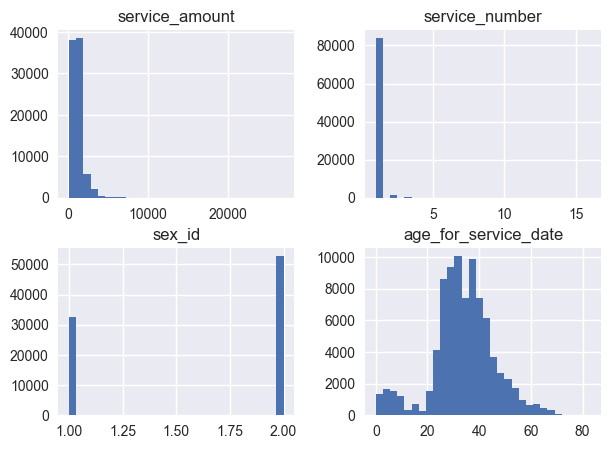

In [15]:
# гистограмма для всех числовых столбцов
data[['service_amount', 'service_number', 'sex_id', 'age_for_service_date']].hist(bins=30, figsize=(7,5));

**Промежуточные выводы:** 
* необходимо изменить тип данных service_date на datetime
* проверить пропуски в столбце sex_id, а также обозначить какое число какому полу соответствует
* названия столбцов корректные
* большая часть услуг находится в диапазоне до 5000 р. Есть выбросы до 25000 руб, нужно оценить, реальны ли эти услуги
* большая часть пациентов возраста от 20 до 45 лет. Наблюдается провал для пациентов примерно от 14 до 20 лет, я думаю - это учащиеся средних-специальных и высших учебных заведений, как правило они прикреплены к клиникам учебных заведений
* колонка 'service_number' содержит практически одни единицы, значит услуги в 'service_name' в основном записаны обособленно, а не комплексно. Нужно оценить выбросы в количестве до 15 услуг

<a id='data_preparation'></a>
## 4. Предобработка данных

<a id='data_format'></a>
### 4.1. Изменение формата даты и добавления столбцов 'year' и 'month'

In [16]:
data['service_date'] = pd.to_datetime(data['service_date'])
start_data = data['service_date'].min()
end_data = data['service_date'].max()
print(f'Начало исследования: {start_data} \nКонец исследования: {end_data} ')

Начало исследования: 2021-01-03 00:00:00 
Конец исследования: 2022-08-31 00:00:00 


In [17]:
data['month'] = data['service_date'].dt.date.astype('datetime64[M]')
data['year'] = data['service_date'].dt.year
data['month_n'] = data['service_date'].dt.month
data['month_p'] = data['month'].dt.strftime('%Y-%m')

<a id='sex_id'></a>
### 4.2. Обработка пропусков в 'sex_id' и определение пола клиента

In [18]:
# заполнение пропусков по известному insured
print(data['sex_id'].unique())
data.loc[data['sex_id'].isna(), 'sex_id'] = (
    data.loc[data['sex_id'].isna(), 'insured'].map(data.groupby('insured')['sex_id'].first())
)
data[data['sex_id'].isna()]

[ 2.  1. nan]


,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p
8880,30620882903,2021-04-22,Прием первичный,1470,1,221581,NaN,42,2021-04-01,2021,4,2021-04
8881,30620883003,2021-04-29,Прием повторный,1313,1,221581,NaN,42,2021-04-01,2021,4,2021-04
12357,30786036703,2021-05-31,Прием первичный,1470,1,221581,NaN,42,2021-05-01,2021,5,2021-05
17987,30961733903,2021-06-21,Прием повторный,1313,1,221581,NaN,42,2021-06-01,2021,6,2021-06


In [19]:
# пропусков всего 4, можно удалить
data = data.dropna(subset=['sex_id']).reset_index(drop=True)

In [20]:
# проверка соответствия числа полу
data.loc[(data['service_name'].str.find('гинекол') != -1)].head()

,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p
147,30268171703,2021-01-25,Ультразвуковое исследование гинекология трансв...,2100,1,535243,2.000,38,2021-01-01,2021,1,2021-01
272,30268184203,2021-01-22,Ультразвуковое исследование гинекология (сочет...,2625,1,490772,2.000,35,2021-01-01,2021,1,2021-01
282,30268185203,2021-01-30,Ультразвуковое исследование гинекология трансв...,2100,1,243296,2.000,51,2021-01-01,2021,1,2021-01
359,30268192903,2021-01-26,Ультразвуковое исследование гинекология трансв...,2100,1,488030,2.000,23,2021-01-01,2021,1,2021-01
423,30268199303,2021-01-03,Ультразвуковое исследование гинекология трансв...,2100,1,530864,2.000,24,2021-01-01,2021,1,2021-01


In [21]:
data.loc[data['sex_id'] == 2, 'sex_id'] = 'женский'
data.loc[data['sex_id'] == 1, 'sex_id'] = 'мужской'


In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85365 entries, 0 to 85364
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   record_id             85365 non-null  int64         
 1   service_date          85365 non-null  datetime64[ns]
 2   service_name          85365 non-null  object        
 3   service_amount        85365 non-null  int64         
 4   service_number        85365 non-null  int64         
 5   insured               85365 non-null  int64         
 6   sex_id                85365 non-null  object        
 7   age_for_service_date  85365 non-null  int64         
 8   month                 85365 non-null  datetime64[ns]
 9   year                  85365 non-null  int64         
 10  month_n               85365 non-null  int64         
 11  month_p               85365 non-null  object        
dtypes: datetime64[ns](2), int64(7), object(3)
memory usage: 7.8+ MB


**Промежуточный вывод:** Пропуски убраны, типы данных изменены. Теперь нужно проверить на явные и неявные дубликаты. Неявные дубликаты могут быть только в 'service_name', так как только среди названий услуг клиники могут быть ошибочные символы и пр.

<a id='duplicates'></a>
### 4.3. Обработка явных и неявных дубликатов

In [23]:
print(f'Количество строк-дубликатов: {data.duplicated().sum()}')

Количество строк-дубликатов: 0


In [24]:
data['service_name'].unique()

array(['Прием первичный',
       'Взятие материала на посев, цитологическое исследование ( риноцитограмма)',
       'Посев отдел, дыхательных путей - слизистая зева с определением чувствительности к антибиотикам',
       'Общий анализ крови (лейкоцитарная форм,, СОЭ)',
       'Ревматоидный фактор', 'С-реактивный белок',
       'Взятие крови из периферической вены', 'Магнитотерапия (1 сеанс)',
       'УВЧ-терапия (1 сеанс) (1 поле)', 'Прием повторный',
       'Смазывание глотки лекарственными формами', 'Взятие мазка',
       'Обработка вульвы', 'Обработка шейки матки',
       'Гинекологический мазок', 'Общий анализ мочи', 'Креатинин',
       'Мочевая кислота', 'Мочевина', 'Общий белок',
       'Ультразвуковое исследование почек и надпочечников',
       'Ультразвуковое исследование мочевого пузыря',
       'ЛПНП (липопротеиды низкой плотности, бета-липопротеиды)',
       'Триглицериды', 'Холестерин', 'АЛТ (аланинаминотрансфераза)',
       'Альдостерон', 'Кортизол (кровь)', 'Ренин + Ангио

In [25]:
# чтобы исключить дубликаты, связанные с запятыми, пробелами, 
# уберем их в начале и в конце строк (при наличии) и заменим их на '_'
data['service_name'] = data['service_name'].str.strip(' ')
data['service_name'] = data['service_name'].str.replace(', ', '_')
data['service_name'] = data['service_name'].str.replace(' ', '_')
data['service_name'] = data['service_name'].str.replace(',', '_')
data['service_name'] = data['service_name'].str.replace('__', '_')
data['service_name'] = data['service_name'].str.lower()

In [26]:
# повторная проверка на явные дубликаты
print(data.duplicated().sum())
data[data.duplicated(subset=['service_date', 'service_name', 'insured'])]

0


,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p
93,30268166303,2021-01-05,прием_повторный,1313,1,402409,женский,36,2021-01-01,2021,1,2021-01
104,30268167403,2021-01-05,прием_первичный,1470,1,418179,мужской,40,2021-01-01,2021,1,2021-01
143,30268171303,2021-01-21,прием_повторный,1313,1,166120,женский,33,2021-01-01,2021,1,2021-01
175,30268174503,2021-01-14,прием_первичный,1470,1,534495,женский,25,2021-01-01,2021,1,2021-01
177,30268174703,2021-01-15,прием_первичный,1470,1,221536,мужской,35,2021-01-01,2021,1,2021-01
...,...,...,...,...,...,...,...,...,...,...,...,...
80596,32978946303,2022-07-26,mycoplasma_genitalium_(соскоб),400,1,1155124,женский,40,2022-07-01,2022,7,2022-07
81336,32979021003,2022-07-12,взятие_крови_из_периферической_вены,187,1,629910,женский,40,2022-07-01,2022,7,2022-07
83237,33177757403,2022-08-01,исследование_отделяемого_молочной_железы,1000,1,1302956,женский,39,2022-08-01,2022,8,2022-08
84240,33177965603,2022-08-08,взятие_мазка,792,2,935534,женский,37,2022-08-01,2022,8,2022-08


**Промежуточный вывод:** неявные дубликаты частично исключены, явных дубликатов- строк нет. Искать явные дубликаты сочетаний столбцов нет смысла, так как у одного и того же клиента в один день услуга может повторяться сколько угодно раз

<a id='service_category'></a>
### 4.4. Определение категорий услуг

In [27]:
# категоризация услуг
service_list = (
    {'прием_первичный_специалиста':['первичный', 'прием_психотерапевта', 'прием_психиатра', 'прием_отоневролога',
                                    'консультация_психолога', 'прием_врача_по_лечебной_физкультуре', 'консультация',
                                    'ведущего', 'эксперта', 'профессора', 'руководителя', 'до_мкад', 'за_мкад'],
     'прием_повторный_специалиста':['повторный'],
     'диагностика_и_лечение':['ультра', 'рентг', 'мрт', 'эхо', 'экг', 'ээг', 'метрия','отерапия', '-терапия', 
                              'терапия_(1_сеанс)', 'волновая_терапия', 'лфк', 'сканирование', 
                              'эзофагогастродуоденоскопия', 'осмотр', 'глазного', 'подбор', 'электрофорез',
                              'вестибулярных_тестов', 'электронейромиография', 'зрен', 'перевязка', 'гастроскопия',
                              'хирургическая', 'биопсия', 'колоноскопия'],
     'массаж_рефлексотерапия':['классический_лечебный_массаж', 'массаж_век', 'массаж_пояснично-крестцового',
                               'массаж_для_детей', 'мануальная_терапия', 'комплексная_мануальная_терапия', 
                               'сеанс_рефлексотерапии'],
     'анализы':['кров', 'антитела', 'igg', 'igm', 'посев', 'анализ', 'ige',
                'мазок', 'мазка', 'экспресс', 'кала', 'мочи', 'моча', 'белок', 'тромб', 'билирубин', 'пыльца']
    }
) 

In [28]:
def service_categories(purpose):
    for category, items_list in service_list.items():
        for item in items_list:
            if item in purpose:
                return category
    return 'остальное'

In [29]:
data['service_category'] = data['service_name'].apply(service_categories)

In [30]:
# проверка
data.query('service_category == "прием_повторный_специалиста"')['service_name'].unique()

array(['прием_повторный', 'прием_рефлексотерапевта_повторный',
       'прием_мануального_терапевта_повторный',
       'прием_травматолога-ортопеда_повторный', 'прием_уролога_повторный',
       'прием_терапевта_повторный', 'прием_гинеколога_повторный',
       'прием_эндокринолога_повторный', 'прием_педиатра_повторный',
       'прием_хирурга_повторный', 'прием_гастроэнтеролога_повторный',
       'прием_онколога_повторный', 'прием_невролога_повторный',
       'прием_отоларинголога_повторный', 'прием_физиотерапевта_повторный',
       'прием_дерматолога_повторный', 'прием_кардиолога_повторный',
       'прием_пульмонолога_повторный', 'прием_офтальмолога_повторный',
       'прием_аллерголога_повторный', 'прием_ревматолога_повторный',
       'прием_проктолога_повторный', 'прием_нефролога_повторный'],
      dtype=object)

Для анализа первичного и повторного приемов убираем информацию о специализации, и добавляем все в новый столбец

In [32]:
data['new_service_name'] = data['service_name'].apply(set_service)
data.head()

,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p,service_category,new_service_name
0,30268157003,2021-01-24,прием_первичный,1470,1,490777,женский,26,2021-01-01,2021,1,2021-01,прием_первичный_специалиста,прием_первичный
1,30268157103,2021-01-24,взятие_материала_на_посев_цитологическое_иссле...,284,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,взятие_материала_на_посев_цитологическое_иссле...
2,30268157203,2021-01-24,посев_отдел_дыхательных_путей_-_слизистая_зева...,1134,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,посев_отдел_дыхательных_путей_-_слизистая_зева...
3,30268157303,2021-01-24,общий_анализ_крови_(лейкоцитарная_форм_соэ),693,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,общий_анализ_крови_(лейкоцитарная_форм_соэ)
4,30268157403,2021-01-24,ревматоидный_фактор,420,1,490777,женский,26,2021-01-01,2021,1,2021-01,остальное,ревматоидный_фактор


<a id='age_category'></a>
### 4.5. Определение возрастных категорий

In [33]:
# Проверим, какие значения возрастов имеютя в данных, нет ли каких-нибудь аномалий:
print(f'Минимальный возраст пациента: {data["age_for_service_date"].min()}')
print(f'Минимальный возраст пациента: {data["age_for_service_date"].max()}')
data['age_for_service_date'].unique()

Минимальный возраст пациента: 0
Минимальный возраст пациента: 83


array([26, 25, 40, 35, 43, 48, 36,  2, 30,  1, 44, 32,  0, 28, 34,  4, 37,
       33, 38, 49, 45, 39, 51, 31, 23, 24, 27, 16,  5, 13, 42, 11, 29, 21,
        3, 65, 60,  6, 55, 68, 52, 47, 58,  8, 22, 50, 63,  7, 53, 62, 46,
       56,  9, 41, 61, 57, 14, 54, 10, 15, 18, 19, 12, 59, 17, 67, 83, 64,
       72, 20, 70, 66, 74, 75, 71, 69], dtype=int64)

In [34]:
fig = px.histogram(data, x="age_for_service_date")
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Распределение пациентов по возрасту',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations,
    xaxis={'title':'возраст', 'showticklabels': True},
    yaxis={'title':'кол-во пациентов', 'showticklabels': True})
fig.show()


**Промежуточный вывод:** 
* нужно разделить пациентов на категории по возрасту
* самые больные — 34-летние пациенты, также пики в 25, 30, 37 лет — вот они кризисы разных возрастов
* очень мало пациентов возраста 11-17, а 18-летних практически нет. Обычно школьники и студенты проходят диспансеризацию в прикрепленых к своим учебным заведениям клиниках, а также в военкоматах

In [35]:
data['age_category'] = data['age_for_service_date'].apply(age_category)
data.head()

,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p,service_category,new_service_name,age_category
0,30268157003,2021-01-24,прием_первичный,1470,1,490777,женский,26,2021-01-01,2021,1,2021-01,прием_первичный_специалиста,прием_первичный,25 <= возраст < 35
1,30268157103,2021-01-24,взятие_материала_на_посев_цитологическое_иссле...,284,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,взятие_материала_на_посев_цитологическое_иссле...,25 <= возраст < 35
2,30268157203,2021-01-24,посев_отдел_дыхательных_путей_-_слизистая_зева...,1134,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,посев_отдел_дыхательных_путей_-_слизистая_зева...,25 <= возраст < 35
3,30268157303,2021-01-24,общий_анализ_крови_(лейкоцитарная_форм_соэ),693,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,общий_анализ_крови_(лейкоцитарная_форм_соэ),25 <= возраст < 35
4,30268157403,2021-01-24,ревматоидный_фактор,420,1,490777,женский,26,2021-01-01,2021,1,2021-01,остальное,ревматоидный_фактор,25 <= возраст < 35


<a id='amount_category'></a>
### 4.6. Определение ценовых категорий

In [36]:
fig = px.scatter(data, x="service_date", y="service_amount", marginal_y="histogram")
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Разброс стоимости услуг',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations,
    xaxis={'title':'даты визитов', 'showticklabels': True},
    yaxis={'title':'стоимсоть услуги', 'showticklabels': True})
fig.show()

In [37]:
# проверка значений выбросов
data.query('service_amount >=10000')

,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p,service_category,new_service_name,age_category
8316,30620826503,2021-04-13,мскт_почек_и_надпочечников_с_внутривенным_болю...,11025,1,544444,мужской,31,2021-04-01,2021,4,2021-04,остальное,мскт_почек_и_надпочечников_с_внутривенным_болю...,25 <= возраст < 35
15585,30961493203,2021-06-17,мрт_брюшной_полости_и_забрюшинного_пространств...,17325,1,634755,мужской,41,2021-06-01,2021,6,2021-06,диагностика_и_лечение,мрт_брюшной_полости_и_забрюшинного_пространств...,35 <= возраст < 45
16370,30961571703,2021-06-06,мскт_мочевыделительной_системы_с_внутривенным_...,12075,1,634765,мужской,42,2021-06-01,2021,6,2021-06,остальное,мскт_мочевыделительной_системы_с_внутривенным_...,35 <= возраст < 45
16561,30961590803,2021-06-06,вскрытие_абсцесса_различной_локализации,12810,2,181718,женский,34,2021-06-01,2021,6,2021-06,остальное,вскрытие_абсцесса_различной_локализации,25 <= возраст < 35
18514,30961787003,2021-06-24,тотальная_внутривенная_анестезия_от_20_минут_д...,11550,1,362928,женский,51,2021-06-01,2021,6,2021-06,остальное,тотальная_внутривенная_анестезия_от_20_минут_д...,45 <= возраст < 55
18515,30961787103,2021-06-24,гистерорезектоскопия_при_полипах_рдв,26999,1,362928,женский,51,2021-06-01,2021,6,2021-06,остальное,гистерорезектоскопия_при_полипах_рдв,45 <= возраст < 55
23790,31249334503,2021-08-20,мрт_головного_мозга_и_гипофиза_с_контрастирова...,15225,1,544627,женский,34,2021-08-01,2021,8,2021-08,диагностика_и_лечение,мрт_головного_мозга_и_гипофиза_с_контрастирова...,25 <= возраст < 35
27990,31408821503,2021-09-09,мультипараметрическая_мрт_предстательной_желез...,14175,1,531654,мужской,59,2021-09-01,2021,9,2021-09,диагностика_и_лечение,мультипараметрическая_мрт_предстательной_желез...,55 <= возраст < 65
36344,31680600903,2021-11-07,мскт_органов_брюшной_полости_и_забрюшинного_пр...,12680,1,716141,женский,31,2021-11-01,2021,11,2021-11,остальное,мскт_органов_брюшной_полости_и_забрюшинного_пр...,25 <= возраст < 35
36756,31680642403,2021-11-20,мскт_органов_брюшной_полости_и_забрюшинного_пр...,12680,1,743829,мужской,42,2021-11-01,2021,11,2021-11,остальное,мскт_органов_брюшной_полости_и_забрюшинного_пр...,35 <= возраст < 45


In [38]:
# на основании графика разброса цен на услуги, разобьем услуги на ценовые категории
data['amount_category'] = data['service_amount'].apply(amount_category)
data.head()

,record_id,service_date,service_name,service_amount,service_number,insured,sex_id,age_for_service_date,month,year,month_n,month_p,service_category,new_service_name,age_category,amount_category
0,30268157003,2021-01-24,прием_первичный,1470,1,490777,женский,26,2021-01-01,2021,1,2021-01,прием_первичный_специалиста,прием_первичный,25 <= возраст < 35,1100 <= стоимость услуги < 1650
1,30268157103,2021-01-24,взятие_материала_на_посев_цитологическое_иссле...,284,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,взятие_материала_на_посев_цитологическое_иссле...,25 <= возраст < 35,0 <= стоимость услуги < 600
2,30268157203,2021-01-24,посев_отдел_дыхательных_путей_-_слизистая_зева...,1134,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,посев_отдел_дыхательных_путей_-_слизистая_зева...,25 <= возраст < 35,1100 <= стоимость услуги < 1650
3,30268157303,2021-01-24,общий_анализ_крови_(лейкоцитарная_форм_соэ),693,1,490777,женский,26,2021-01-01,2021,1,2021-01,анализы,общий_анализ_крови_(лейкоцитарная_форм_соэ),25 <= возраст < 35,600 <= стоимость услуги < 1100
4,30268157403,2021-01-24,ревматоидный_фактор,420,1,490777,женский,26,2021-01-01,2021,1,2021-01,остальное,ревматоидный_фактор,25 <= возраст < 35,0 <= стоимость услуги < 600


**Промежуточный вывод:**
* услуги стоимостью >=10 т.р. — это реальные услуги, в основном хирургические операции и МРТ исследования.
* с января 2022 года данные дорогие услуги практически исчезли. В Июле они снова начали появляться (от 6000 до 8000 р.). Возможно это связано с проблемами с МРТ аппаратом, а также увольнением специалистов.
* по общей массе можно отметить увеличение разброса стоимости услуг, начиная с октября 2021 года.


<a id='data_analysis'></a>
## 5. Исследовательский анализ данных

<a id='total_amount'></a>
### 5.1. Динамика выручки

Для начала посмотрим на динамику всей выручки по месяцам и годам
<a id='total_amount'></a>

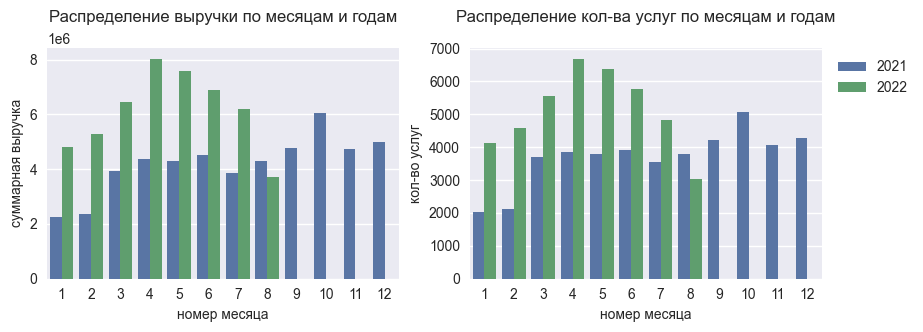

In [39]:
# расчет суммарной выручки по месяцам и сравнение 2021 года и 2022
# расчет кол-ва услуг по месяцам и сравнение 2021 года и 2022
data_month_service = data.groupby(['year','month_n'], as_index=False).agg({'service_amount':['sum','count']})
data_month_service.columns = data_month_service.columns.map('_'.join)
data_month_service = data_month_service.rename(columns={'year_':'year', 'month_n_':'month_n'})

plt.figure(figsize=(10,3))

ax1 = plt.subplot(1,2,1)
sns.barplot(data=data_month_service, x='month_n',y='service_amount_sum', hue='year')
plt.title('Распределение выручки по месяцам и годам\n', fontsize=12)
plt.xlabel('номер месяца', fontsize=10)
plt.ylabel('суммарная выручка', fontsize=10)
ax1.legend_.remove()

ax2 = plt.subplot(1,2,2)
sns.barplot(data=data_month_service, x='month_n',y='service_amount_count', hue='year')
plt.title('Распределение кол-ва услуг по месяцам и годам\n', fontsize=12)
plt.xlabel('номер месяца', fontsize=10)
plt.ylabel('кол-во услуг', fontsize=10)
plt.legend(bbox_to_anchor=(1.01, 1.0), fontsize=10)

plt.show()

In [40]:
print(f'Общая выручка за 2021 год (с 01 по 12 месяц): {data_month_service.query("year == 2021")["service_amount_sum"].sum()}')
print(f'Общая выручка за 2022 год (с 01 по 08 месяц): {data_month_service.query("year == 2022")["service_amount_sum"].sum()}')

Общая выручка за 2021 год (с 01 по 12 месяц): 50556105
Общая выручка за 2022 год (с 01 по 08 месяц): 48986662


In [41]:
# расчет разницы выручки по месяцам 2021 и 222 года, в %
data_amount = data.pivot_table(index='year', columns='month_n', values='service_amount', aggfunc=['sum', 'count']).fillna(0).T
data_amount.columns = ['2021', '2022']
data_amount['2022_/_2021_%'] = 100 * data_amount['2022'] / data_amount['2021'] - 100
data_amount

2021          2022  2022_/_2021_%
      month_n                                           
sum   1       2,265,931.000 4,800,320.000        111.848
      2       2,379,125.000 5,298,235.000        122.697
      3       3,927,248.000 6,451,060.000         64.264
      4       4,377,704.000 8,035,080.000         83.546
      5       4,297,508.000 7,588,110.000         76.570
      6       4,521,272.000 6,879,580.000         52.160
      7       3,872,209.000 6,216,498.000         60.541
      8       4,310,989.000 3,717,779.000        -13.760
      9       4,782,859.000         0.000       -100.000
      10      6,063,580.000         0.000       -100.000
      11      4,747,330.000         0.000       -100.000
      12      5,010,350.000         0.000       -100.000
count 1           2,021.000     4,143.000        104.998
      2           2,120.000     4,586.000        116.321
      3           3,696.000     5,547.000         50.081
      4           3,867.000     6,692.000         73.054
      5           3,787.000     6,374.000         68.313
      6           3,914.000     5,765.000         47.292
      7           3,545.000     4,841.000         36.559
      8           3,782.000     3,029.000        -19.910
      9           4,229.000         0.000       -100.000
      10          5,065.000         0.000       -100.000
      11          4,074.000         0.000       -100.000
      12          4,288.000         0.000       -100.000

**Промежуточный вывод:**
* несмотря на то, что 2022 год только до 08 месяца, его выручка практически равна выручке полного 2021 года
* зависимость динамики изменения выручки практически прямопропорциональна динамике изменения кол-ва услуг, но при этом за каждый месяц 2022 года до июня включительно выручка увеличилась на большее число процентов, чем количество услуг(на 7-10%).
* в июле же 2022 года выручка больше выручки 07.2021 на 60%, а количесвто услуг на 36,6%, это гворит о том, что услуги в 2022 году дороже, чем те же улуги в 2021 году.
* характер линии изменений кол-ва услуг и выручки по месцам в 2022 году такой же как и в 2021 с 01 по 07 месяцы. 
* Выделяется резкий скачок 04.2022 года (в 2021 лишь небольшой рост), а также падение 08.2022 (в 2021 году в августе наблюдается рост кол-ва услуг и выручки).


<a id='visits'></a>
### 5.2. Расчет визитов и средней стоимости услуг за визит

Визит — уникальное сочетание даты создания услуги и идентификатора застрахованного.

In [42]:
# группируем по дням и номерам застрахованнных, 
# для каждого застрахованного считаем количество услуг, которое он получил, 
# среднюю стоимость одной услуги, и полную стоимость визита
visits_insured = (
    data.groupby(['service_date','insured'], as_index=False)
    .agg({'service_name':'count', 'service_amount':['mean', 'sum'], 'sex_id':'last', 'age_category':'first'})
) 
visits_insured.columns = visits_insured.columns.map('_'.join)
visits_insured = visits_insured.rename(columns={'service_date_':'service_date', 'insured_':'insured'})
visits_insured['week'] = visits_insured['service_date'].dt.date.astype('datetime64[W]')
visits_insured['month'] = visits_insured['service_date'].dt.date.astype('datetime64[M]')
visits_insured

,service_date,insured,service_name_count,service_amount_mean,service_amount_sum,sex_id_last,age_category_first,week,month
0,2021-01-03,142427,1,"1,313.000",1313,мужской,25 <= возраст < 35,2020-12-31,2021-01-01
1,2021-01-03,142562,1,"1,470.000",1470,мужской,35 <= возраст < 45,2020-12-31,2021-01-01
2,2021-01-03,174009,4,696.000,2784,мужской,0 <= возраст < 18,2020-12-31,2021-01-01
3,2021-01-03,176359,4,"1,289.250",5157,женский,35 <= возраст < 45,2020-12-31,2021-01-01
4,2021-01-03,194308,3,291.000,873,женский,25 <= возраст < 35,2020-12-31,2021-01-01
...,...,...,...,...,...,...,...,...,...
30285,2022-08-31,1303034,1,"1,620.000",1620,женский,18 <= возраст < 25,2022-08-25,2022-08-01
30286,2022-08-31,1303046,3,"2,726.667",8180,мужской,0 <= возраст < 18,2022-08-25,2022-08-01
30287,2022-08-31,1306753,3,815.333,2446,женский,35 <= возраст < 45,2022-08-25,2022-08-01
30288,2022-08-31,1306765,3,"2,160.000",6480,женский,25 <= возраст < 35,2022-08-25,2022-08-01


In [43]:
fig = px.scatter(visits_insured, x="service_date", y="service_amount_sum", marginal_y="histogram")
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Разброс стоимостей визитов во времени',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations,
    xaxis={'title':'даты визитов', 'showticklabels': True},
    yaxis={'title':'стоимость визита', 'showticklabels': True})
fig.show()

**Промежуточный вывод:**
* по общей массе можно отметить увеличение разброса стоимостей визитов с течением времени
* больше всего визитов стоимостью 1300-1400 и 1500-1600 - очень похоже на один прием врача

In [44]:
fig = px.scatter(visits_insured, x="service_date", y="service_amount_mean", marginal_y="histogram")
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Разброс средней стоимости услуги за визит',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations,
    xaxis={'title':'даты визитов', 'showticklabels': True},
    yaxis={'title':'средняя стоимость услуги за визит', 'showticklabels': True})
fig.show()

**Промежуточный вывод:**
* по общей массе можно также отметить повышение средней стоимости самых распространенных услуг за визит с октября 2021 года. Рассморим детальное изменение цен на самые распространенные услуги далее.
* распространенные стоимости услуг за визит: 553, 950-1100, 1300-1350, 1350-1400, 1450-1500, 1500-1550, 1600-1650, 1900-1950, 2200-2250, 3300-3350

In [45]:
# расчитаем количество визитов, их среднюю стоимость и среднее количество услуг за визит в клинике за каждый день
visits_day = (
    visits_insured.groupby('service_date', as_index=False)
    .agg({'insured':'count', 'service_amount_sum':'mean', 'service_name_count':'mean'})
)
visits_day['year'] = visits_day['service_date'].dt.year
visits_day

,service_date,insured,service_amount_sum,service_name_count,year
0,2021-01-03,12,"3,222.167",4.083,2021
1,2021-01-04,19,"3,335.895",2.895,2021
2,2021-01-05,28,"3,713.893",3.821,2021
3,2021-01-06,23,"2,510.261",2.696,2021
4,2021-01-07,20,"2,909.150",2.550,2021
...,...,...,...,...,...
597,2022-08-27,26,"3,206.077",3.038,2022
598,2022-08-28,24,"2,573.875",2.042,2022
599,2022-08-29,42,"3,676.262",3.167,2022
600,2022-08-30,36,"3,603.028",2.778,2022


In [46]:
print(f'Количество визитов в 2021 году (с 01 по 12 месяц): {visits_day.query("year == 2021")["insured"].sum()}')
print(f'Количество визитов в 2022 году (с 01 по 08 месяц): {visits_day.query("year == 2022")["insured"].sum()}')

Количество визитов в 2021 году (с 01 по 12 месяц): 15856
Количество визитов в 2022 году (с 01 по 08 месяц): 14434


In [47]:
visits_day = filter_data(visits_day, 'insured', 7)

In [48]:
visits_day = filter_data(visits_day, 'service_amount_sum', 7)

In [49]:
visits_day = filter_data(visits_day, 'service_name_count', 7)

<a id='visits_count_day'><a/>

In [50]:
# Create traces
fig = go.Figure()

fig.add_trace(go.Scatter(x=visits_day['service_date'], y=visits_day['insured']))

# Title
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Динамика изменения среднего числа визитов в день',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations)
fig.show()

**Промежуточный вывод:** 
* в рассматриваемый период число визитов в день росло, за исключением государственных праздников и выходных, в которые наблюдаются падения количества визитов и периода 12.21-01.22, в который наблюдается снижение визитов, скорее всего из-за зимних отпусков
* начиная с июня 2022 года и до конца наблюдения (31.08.2021) непрерывное падение количества визитов, хотя в аналогичны период 2021 года после падения в июне 2021 года количество визитов растет

<a id='mean_cost_visit'><a/>

In [51]:
# Create traces
fig = go.Figure()

fig.add_trace(go.Scatter(x=visits_day['service_date'], y=visits_day['service_amount_sum']))

# Title
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Динамика изменения средней стоимости визита в день',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations)
fig.show()

**Промежуточный вывод:**
* средняя стоимость визита увеличивается

<a id='mean_count_service'><a/>

In [52]:
# Create traces
fig = go.Figure()

fig.add_trace(go.Scatter(x=visits_day['service_date'], y=visits_day['service_name_count']))

# Title
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Динамика изменения среднего кол-ва услуг усредненного визита в день',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations)
fig.show()

**Промежуточный вывод:**
* наблюдается снижение разброса среднего количества услуг за визит в день

<a id='visits_month'></a>
### 5.3. Расчет обратившихся в месяц

Обратившийся в месяц — уникальное сочетание месяца оказания услуги и идентификатора застрахованного.

In [53]:
# расчитаем количество обратившихся в месяц в клинике за каждый месяц
unique_visits_month = (
    data.pivot_table(index=['month'], values=['insured'], aggfunc=['nunique', 'count']).reset_index()
)
unique_visits_month.columns = unique_visits_month.columns.map('_'.join)
unique_visits_month = unique_visits_month.rename(columns={'month_':'month'})
unique_visits_month

,month,nunique_insured,count_insured
0,2021-01-01,286,2021
1,2021-02-01,309,2120
2,2021-03-01,446,3696
3,2021-04-01,466,3867
4,2021-05-01,468,3787
5,2021-06-01,434,3914
6,2021-07-01,447,3545
7,2021-08-01,488,3782
8,2021-09-01,559,4229
9,2021-10-01,591,5065


In [54]:
# Create traces
fig = go.Figure()

fig.add_trace(go.Scatter(x=unique_visits_month['month'], y=unique_visits_month['nunique_insured'], 
                         mode='lines', name='кол-во уникальных обратившихся в месяц'))

# Title
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Динамика изменения количества обратившихся в месяц',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations)
fig.show()

**Промежуточный вывод:**

* в рассматриваемый период количество обратившихся в месяц плавно растет, достигает пика  мае 2022 и падает до конца августа. Динамика похожа на сглаженую динамику визитов по неделям
* при этом количество обратившихся в месяц за 06-07.2022 еще больше, чем в 2021, но в августе 2022 уже меньше, чем в 2022
* в ноябре 2021 года наблюдается спад визитов, возможно связано с мобилизацией, возможно сезонное падение, но данных за другие года нет, поэтому можно только предполагать
* одинаковый спад на новогодние праздники и в 2021, и 2022 году - можно отнести к сезонному характеру
* июнь-август 2021 года показывает рост и визитов, и обратившихся в месяц, в 2022 — быстрое падение

<a id='visit_1'></a>
### 5.4. Оценка пациентов с точки зрения "разовых" и "постоянных" клиентов

Рассмотрим, сколько всего застрахованных посетило клинику

In [55]:
# для каждого 'insured' считаем количество уникальных визитов и месяцев с визитами
insured_unique = (
    data.groupby(['insured'], as_index=False)
    .agg({'service_date':'nunique', 'month':'nunique'})
    .sort_values(by='service_date')
)
insured_unique

,insured,service_date,month
1695,627743,1,1
1646,608178,1,1
1643,603909,1,1
3911,1073394,1,1
3914,1073404,1,1
...,...,...,...
159,180725,73,8
1772,634801,75,9
681,402409,75,17
711,418193,78,11


In [56]:
fig = px.histogram(insured_unique, x="service_date")
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Распределение пациентов по количеству визитов',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations,
    xaxis={'title':'кол-во визитов', 'showticklabels': True},
    yaxis={'title':'кол-во пациентов', 'showticklabels': True})
fig.show()

**Промежуточный вывод:**
* всего клинику посетило 4487 пациента
* 25% застрахованных посетило клиниику только один раз. Расссмотрим их поподробней, так как 1/4 часть от всех пациентов - это довольно много
* 25% застрахованных посетило клиниику 2-3 раза
* оставшиеся 50% пациентов посетило клинику от 4 до 94 раз


In [57]:
# вытаскиваем пациентов, которые пришли в клинику только раз
insured_list = insured_unique.query('service_date == 1')['insured']
data_1 = data.query('insured in @insured_list')
rate_1 = data_1["service_amount"].sum()/data["service_amount"].sum()
print(f'Выручка от "разовых" посетителей в рассматриваемый период: {data_1["service_amount"].sum()}')
print(f'Выручка в рассматриваемый период по всем данным: {data["service_amount"].sum()}')
print(f'Доля от общей выручки, которую принесли "разовые" пациениты: {rate_1:.3%}')

Выручка от "разовых" посетителей в рассматриваемый период: 3496131
Выручка в рассматриваемый период по всем данным: 99542767
Доля от общей выручки, которую принесли "разовые" пациениты: 3.512%


<a id='one_time_insured'><a/>

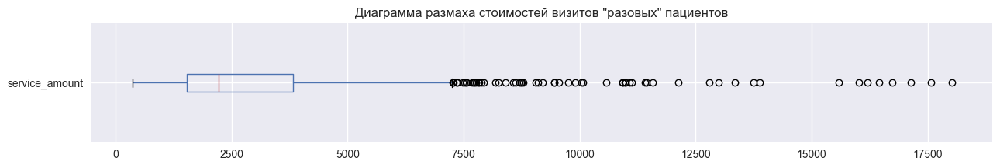

count    1,133.000
mean     3,085.729
std      2,364.520
min        360.000
25%      1,540.000
50%      2,220.000
75%      3,830.000
max     18,018.000
Name: service_amount, dtype: float64

In [58]:
# оценка стомости визитов "разовых" пациентов
visit_1 = data_1.groupby('insured', as_index=False)['service_amount'].sum()
(
    visit_1.boxplot(column='service_amount', figsize=(15,2), vert = False)
    .set_title('Диаграмма размаха стоимостей визитов "разовых" пациентов')
)

plt.show()
visit_1['service_amount'].describe()

**Промежуточный вывод:**
* по медианному значению можно предположить, что "разовый" визит — это прием врача и какие-то анализы. Есть небольшое кол-во выбросов, которые показывают стоимсоть визитов, в которых комплекс услуг
* всего 3,5% от всей выручки от 25% пациентов - это незначительно, поэтому дальше "разовых" пациентов рассматривать не будем
* основную выручку принесли пациенты, которые приходили более 1 раза

<a id='top_10'></a>
### 5.5. Динамика изменения стоимости самых популярных услуг по месяцам

#### Процентное соотношение количества услуг по категориям за каждый месяц

<a id='rate_service_cat'><a/>

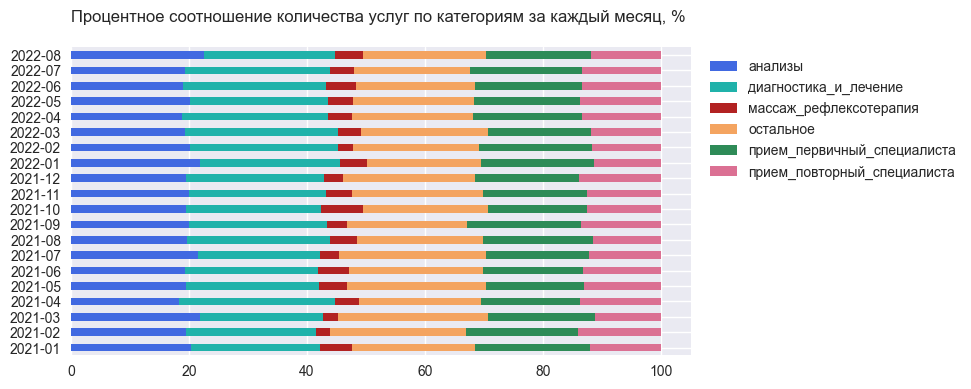

In [59]:
# ежемесячное распределение категорий услуг
data_ser_cat = (
    data.pivot_table(
        index='month_p',
        columns='service_category',
        values='service_amount',
        aggfunc='count'
    ).T
)

# перевод в проценты от общего числа услуг за каждый месяц:

for column in data_ser_cat.columns:
    a = data_ser_cat[column].sum()
    for index in data_ser_cat.index:
        data_ser_cat.loc[index, column] = 100 * (data_ser_cat.loc[index, column] / a)

colors=["royalblue", "lightseagreen", "firebrick", "sandybrown", "seagreen", "palevioletred"]        
data_ser_cat.T.plot(kind='barh', stacked=True, figsize=(8,4), color=colors)
plt.ylabel('')
plt.legend(bbox_to_anchor=(1.01, 1.0), fontsize=10)
plt.title(f'Процентное соотношение количества услуг по категориям за каждый месяц, % \n', fontsize=12)
plt.show()

**Промежуточный вывод:**
* распределение услуг по категориям за каждый месяц с течением времени практически не меняется
* в целом количество услуг первичный_прием и повторный_прием составляет около 30% от всех услуг в каждый месяц
* можно отметить, что первичных приемов больше, чем повторных

#### Динамика изменения стоимости популярных услуг по категориям:

<a id='sex_id_service'><a/>

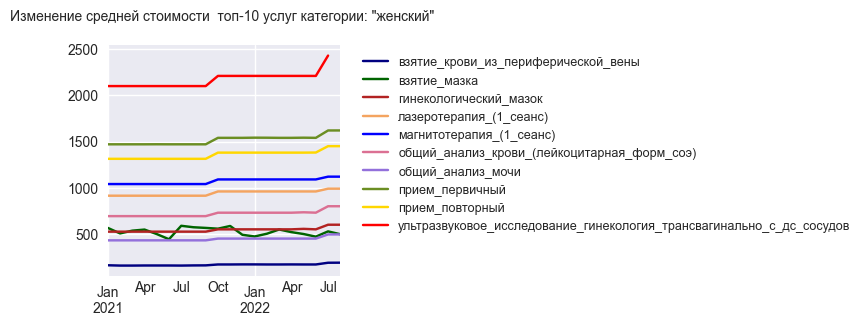

взятие_крови_из_периферической_вены                                     0.148
взятие_мазка                                                           -0.138
гинекологический_мазок                                                  0.125
лазеротерапия_(1_сеанс)                                                 0.077
магнитотерапия_(1_сеанс)                                                0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)                             0.134
общий_анализ_мочи                                                       0.129
прием_первичный                                                         0.093
прием_повторный                                                         0.094
ультразвуковое_исследование_гинекология_трансвагинально_с_дс_сосудов      NaN
dtype: float64


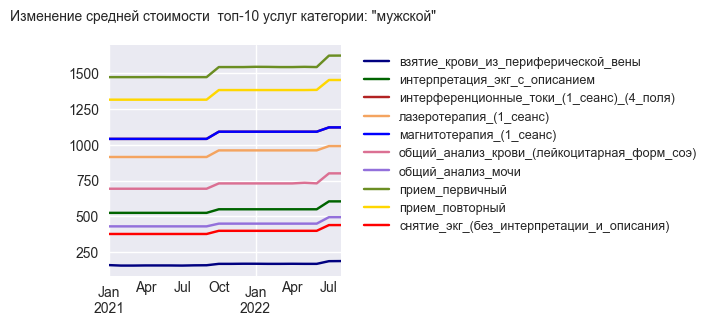

взятие_крови_из_периферической_вены           0.148
интерпретация_экг_с_описанием                 0.132
интерференционные_токи_(1_сеанс)_(4_поля)     0.071
лазеротерапия_(1_сеанс)                       0.077
магнитотерапия_(1_сеанс)                      0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)   0.134
общий_анализ_мочи                             0.129
прием_первичный                               0.093
прием_повторный                               0.094
снятие_экг_(без_интерпретации_и_описания)     0.141
dtype: float64


In [60]:
# по полу пациента 'sex_id'
for dimension in data['sex_id'].unique():
    rise_service = plot_top_10(data, dimension, 'sex_id')
    print(rise_service)

**Промежуточный вывод по категории "sex_id":**
* систематическое повышение стоимости почти всех услуг 10.2021 и 07.2022. Некоторые анализы выросли на 15%, более дорогие исследвания на 7-8%, приемы врачей на 10%
* стоимость практически всех топ-10 услуг обоих полов до 1620


<a id='amount_cat_service'><a/>

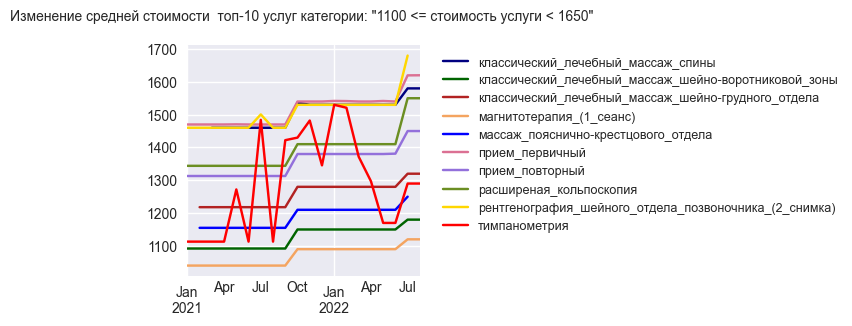

классический_лечебный_массаж_спины                      0.076
классический_лечебный_массаж_шейно-воротниковой_зоны    0.075
классический_лечебный_массаж_шейно-грудного_отдела        NaN
магнитотерапия_(1_сеанс)                                0.071
массаж_пояснично-крестцового_отдела                       NaN
прием_первичный                                         0.093
прием_повторный                                         0.094
расширеная_кольпоскопия                                 0.133
рентгенография_шейного_отдела_позвоночника_(2_снимка)     NaN
тимпанометрия                                           0.137
dtype: float64


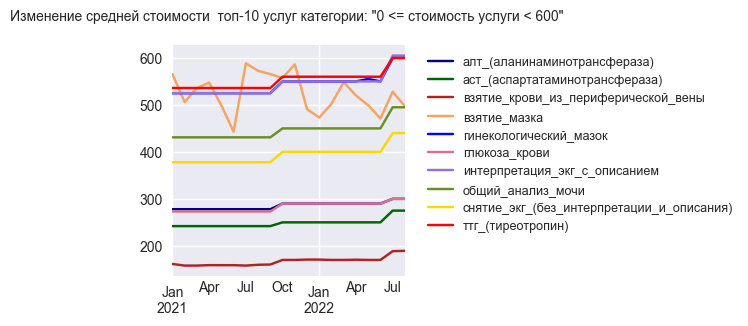

алт_(аланинаминотрансфераза)                 0.073
аст_(аспартатаминотрансфераза)               0.120
взятие_крови_из_периферической_вены          0.148
взятие_мазка                                -0.138
гинекологический_мазок                       0.125
глюкоза_крови                                0.090
интерпретация_экг_с_описанием                0.132
общий_анализ_мочи                            0.129
снятие_экг_(без_интерпретации_и_описания)    0.141
ттг_(тиреотропин)                            0.107
dtype: float64


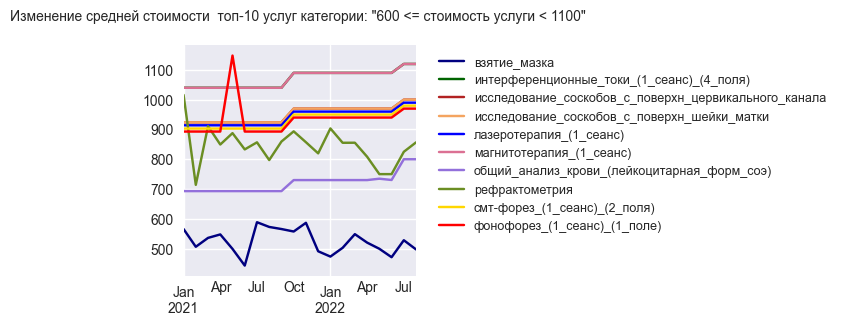

взятие_мазка                                           -0.138
интерференционные_токи_(1_сеанс)_(4_поля)               0.071
исследование_соскобов_с_поверхн_цервикального_канала    0.076
исследование_соскобов_с_поверхн_шейки_матки             0.076
лазеротерапия_(1_сеанс)                                 0.077
магнитотерапия_(1_сеанс)                                0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)             0.134
рефрактометрия                                         -0.186
смт-форез_(1_сеанс)_(2_поля)                            0.079
фонофорез_(1_сеанс)_(1_поле)                            0.079
dtype: float64


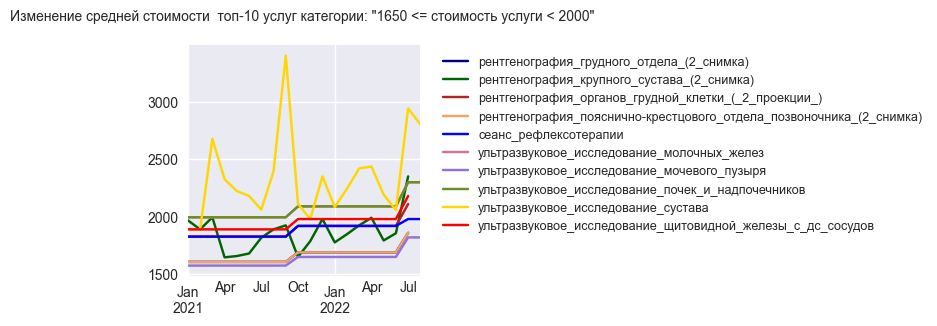

рентгенография_грудного_отдела_(2_снимка)                               NaN
рентгенография_крупного_сустава_(2_снимка)                              NaN
рентгенография_органов_грудной_клетки_(_2_проекции_)                    NaN
рентгенография_пояснично-крестцового_отдела_позвоночника_(2_снимка)     NaN
сеанс_рефлексотерапии                                                 0.077
ультразвуковое_исследование_молочных_желез                            0.133
ультразвуковое_исследование_мочевого_пузыря                           0.135
ультразвуковое_исследование_почек_и_надпочечников                     0.133
ультразвуковое_исследование_сустава                                   0.326
ультразвуковое_исследование_щитовидной_железы_с_дс_сосудов              NaN
dtype: float64


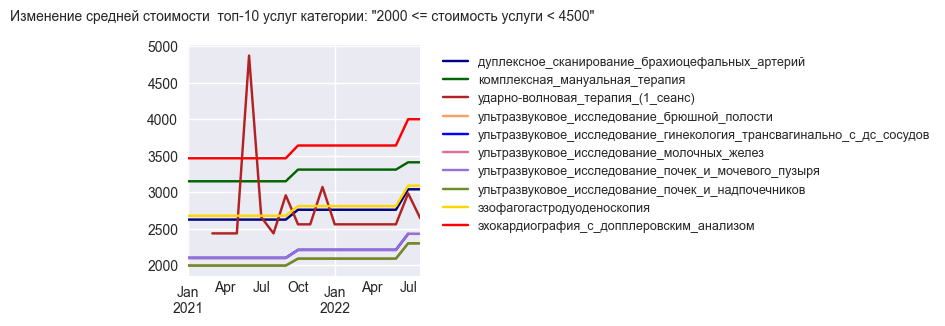

дуплексное_сканирование_брахиоцефальных_артерий                        0.137
комплексная_мануальная_терапия                                         0.076
ударно-волновая_терапия_(1_сеанс)                                        NaN
ультразвуковое_исследование_брюшной_полости                            0.136
ультразвуковое_исследование_гинекология_трансвагинально_с_дс_сосудов     NaN
ультразвуковое_исследование_молочных_желез                             0.133
ультразвуковое_исследование_почек_и_мочевого_пузыря                    0.136
ультразвуковое_исследование_почек_и_надпочечников                      0.133
эзофагогастродуоденоскопия                                             0.133
эхокардиография_с_допплеровским_анализом                               0.134
dtype: float64


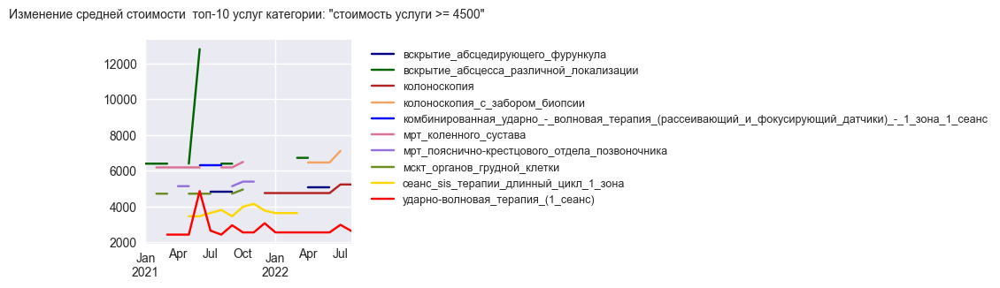

вскрытие_абсцедирующего_фурункула                                                                  NaN
вскрытие_абсцесса_различной_локализации                                                            NaN
колоноскопия                                                                                       NaN
колоноскопия_с_забором_биопсии                                                                     NaN
комбинированная_ударно_-_волновая_терапия_(рассеивающий_и_фокусирующий_датчики)_-_1_зона_1_сеанс   NaN
мрт_коленного_сустава                                                                              NaN
мрт_пояснично-крестцового_отдела_позвоночника                                                      NaN
мскт_органов_грудной_клетки                                                                        NaN
сеанс_sis_терапии_длинный_цикл_1_зона                                                              NaN
ударно-волновая_терапия_(1_сеанс)                                        

In [61]:
for dimension in data['amount_category'].unique():
    rise_service = plot_top_10(data, dimension, 'amount_category')
    print(rise_service)

**Промежуточный вывод по категории "amount_category":**
* систематическое повышение стоимости почти всех услуг 10.2021 и 07.2022
* отличается характер изменения цен для некторых услуг из категорий:
  * средняя: услуга тимпанометрия — свой характер изменения стоимости, имеет отношение к сезону, а точнее к пикам обострений сезонной аллергии
  * низкая+: фонофорез (один выбивающийся пик из общией картины), рефрактометрия, взятие мазка (какая-то хаотичная кривая)
  * средняя+: ультразвуковое_исследование_сустава и рентгенография_крупного_сустава — появление пиков происходит практически в одно время, возможно связано с акциями на диагностику суставов
  * высокая: ударно-волновая_терапия — свой характер кривой
  * высокая+: видно, что с 10.2021 многи услуги пропали вообще, или предоставлялись лишь изредка, ударно-волновая_терапия одним пиком залезла в категорию дорогих услуг


<a id='service_cat_service'><a/>

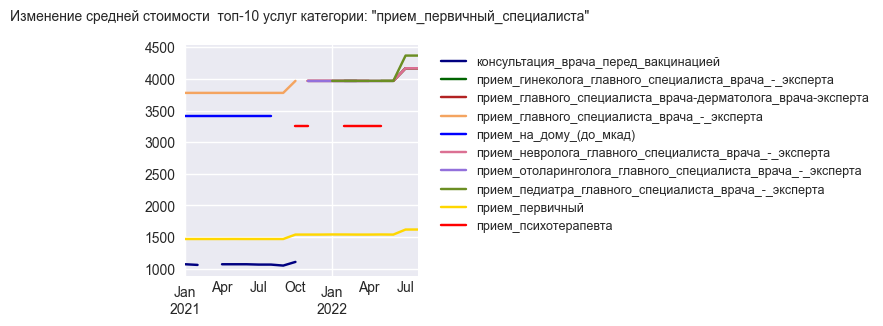

консультация_врача_перед_вакцинацией                            NaN
прием_гинеколога_главного_специалиста_врача_-_эксперта          NaN
прием_главного_специалиста_врача-дерматолога_врача-эксперта     NaN
прием_главного_специалиста_врача_-_эксперта                     NaN
прием_на_дому_(до_мкад)                                         NaN
прием_невролога_главного_специалиста_врача_-_эксперта           NaN
прием_отоларинголога_главного_специалиста_врача_-_эксперта      NaN
прием_педиатра_главного_специалиста_врача_-_эксперта            NaN
прием_первичный                                               0.093
прием_психотерапевта                                          0.091
dtype: float64


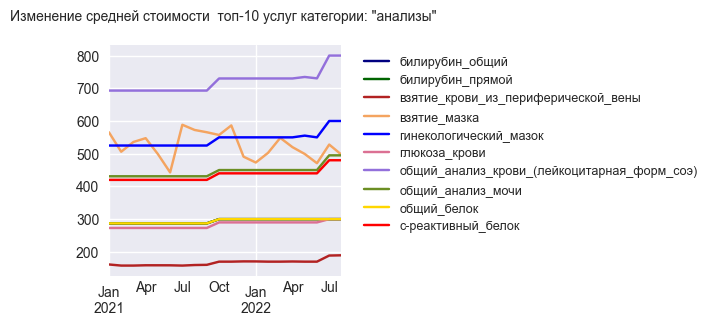

билирубин_общий                                0.043
билирубин_прямой                               0.043
взятие_крови_из_периферической_вены            0.148
взятие_мазка                                  -0.138
гинекологический_мазок                         0.125
глюкоза_крови                                  0.090
общий_анализ_крови_(лейкоцитарная_форм_соэ)    0.134
общий_анализ_мочи                              0.129
общий_белок                                    0.043
с-реактивный_белок                             0.125
dtype: float64


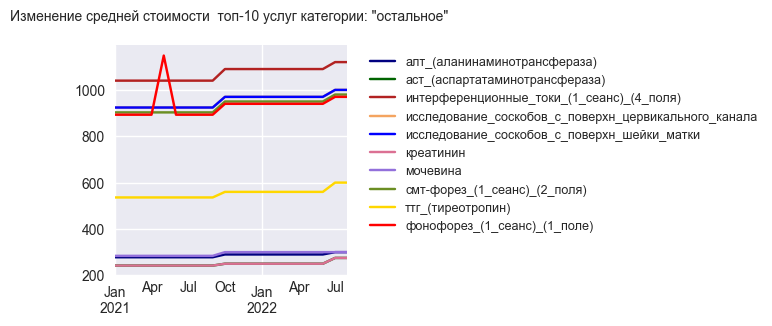

алт_(аланинаминотрансфераза)                           0.073
аст_(аспартатаминотрансфераза)                         0.120
интерференционные_токи_(1_сеанс)_(4_поля)              0.071
исследование_соскобов_с_поверхн_цервикального_канала   0.076
исследование_соскобов_с_поверхн_шейки_матки            0.076
креатинин                                              0.120
мочевина                                               0.053
смт-форез_(1_сеанс)_(2_поля)                           0.079
ттг_(тиреотропин)                                      0.107
фонофорез_(1_сеанс)_(1_поле)                           0.079
dtype: float64


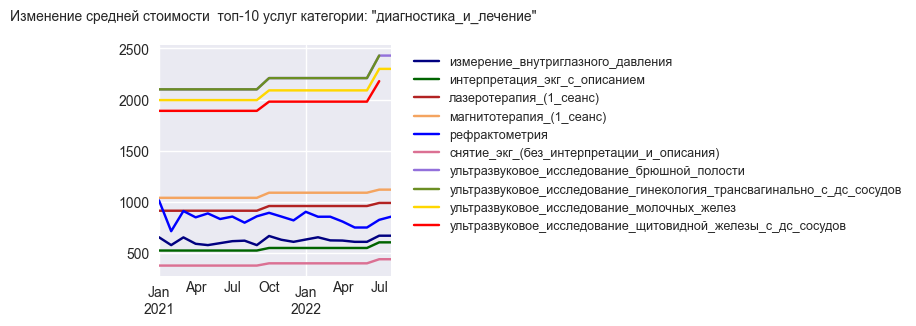

измерение_внутриглазного_давления                                       0.022
интерпретация_экг_с_описанием                                           0.132
лазеротерапия_(1_сеанс)                                                 0.077
магнитотерапия_(1_сеанс)                                                0.071
рефрактометрия                                                         -0.186
снятие_экг_(без_интерпретации_и_описания)                               0.141
ультразвуковое_исследование_брюшной_полости                             0.136
ультразвуковое_исследование_гинекология_трансвагинально_с_дс_сосудов      NaN
ультразвуковое_исследование_молочных_желез                              0.133
ультразвуковое_исследование_щитовидной_железы_с_дс_сосудов                NaN
dtype: float64


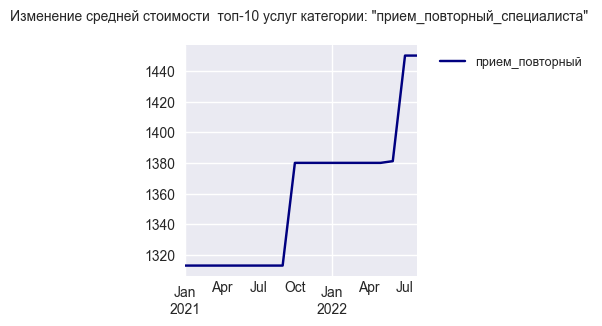

прием_повторный   0.094
dtype: float64


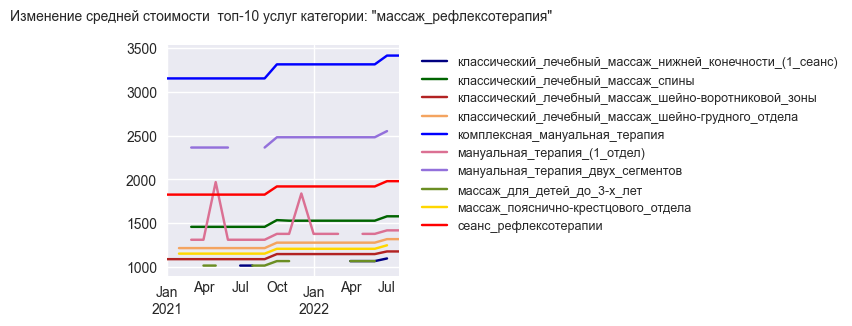

классический_лечебный_массаж_нижней_конечности_(1_сеанс)     NaN
классический_лечебный_массаж_спины                         0.076
классический_лечебный_массаж_шейно-воротниковой_зоны       0.075
классический_лечебный_массаж_шейно-грудного_отдела           NaN
комплексная_мануальная_терапия                             0.076
мануальная_терапия_(1_отдел)                               0.075
мануальная_терапия_двух_сегментов                            NaN
массаж_для_детей_до_3-х_лет                                  NaN
массаж_пояснично-крестцового_отдела                          NaN
сеанс_рефлексотерапии                                      0.077
dtype: float64


In [62]:
for dimension in data['service_category'].unique():
    rise_service = plot_top_10(data, dimension, 'service_category')
    print(rise_service)


**Промежуточный вывод по категории "service_category":**
* систематическое повышение стоимости почти всех услуг 10.2021 и 07.2022
* отличается характер изменения цен для некторых услуг из категорий: 
  * прием_первичный_специалиста: до 10.2021 года были такие услуги как консультация врача перед вакцинацией, а также выезд врача на дом, после 10.2021 года этих услуг уже нет. Я думаю, что они связаны с ковидными мерами
  * анализы: только взятие мазка (что мы уже видели в других категориях) — хаотичная кривая
  * остальное: фонофорез
  * диагнотика_и_лечение: рефрактометрия и измерение_внутрилазного_давления, кривые повторяют друг друга — скорее всего изменение цены связано с акциями на исследование зрения
  * массаж_рефлексотерапия: мануальная_терапия_(1_отдел) имеет 2 пика в мае и декабре 2021 года


<a id='age_cat_service'><a/>

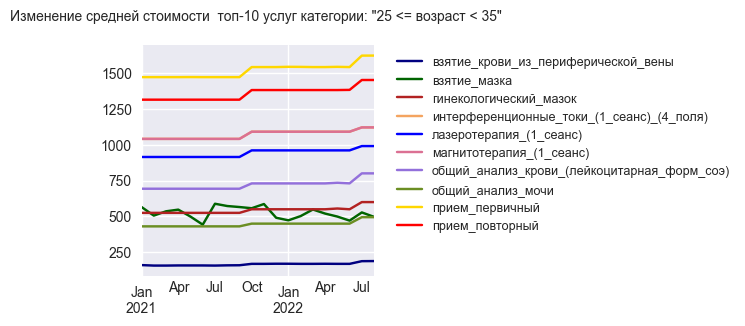

взятие_крови_из_периферической_вены            0.148
взятие_мазка                                  -0.138
гинекологический_мазок                         0.125
интерференционные_токи_(1_сеанс)_(4_поля)      0.071
лазеротерапия_(1_сеанс)                        0.077
магнитотерапия_(1_сеанс)                       0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)    0.134
общий_анализ_мочи                              0.129
прием_первичный                                0.093
прием_повторный                                0.094
dtype: float64


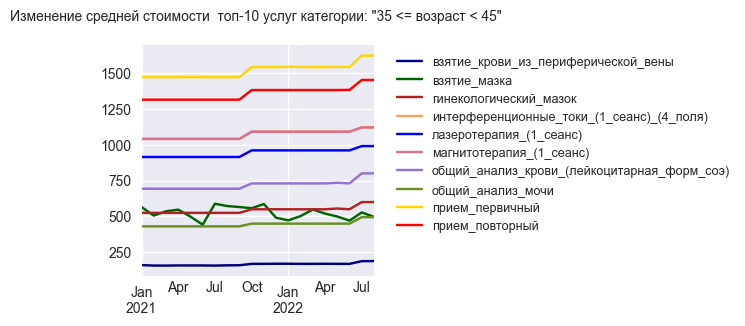

взятие_крови_из_периферической_вены            0.148
взятие_мазка                                  -0.138
гинекологический_мазок                         0.125
интерференционные_токи_(1_сеанс)_(4_поля)      0.071
лазеротерапия_(1_сеанс)                        0.077
магнитотерапия_(1_сеанс)                       0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)    0.134
общий_анализ_мочи                              0.129
прием_первичный                                0.093
прием_повторный                                0.094
dtype: float64


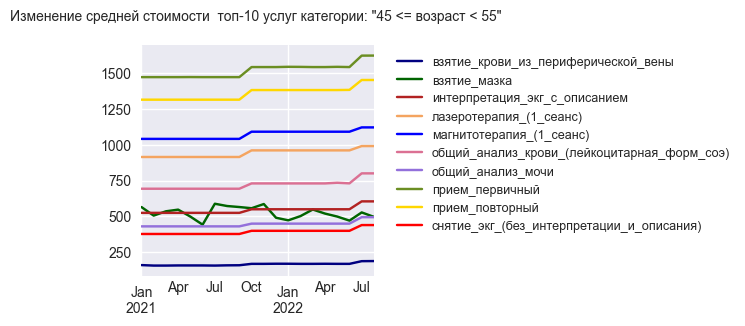

взятие_крови_из_периферической_вены            0.148
взятие_мазка                                  -0.138
интерпретация_экг_с_описанием                  0.132
лазеротерапия_(1_сеанс)                        0.077
магнитотерапия_(1_сеанс)                       0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)    0.134
общий_анализ_мочи                              0.129
прием_первичный                                0.093
прием_повторный                                0.094
снятие_экг_(без_интерпретации_и_описания)      0.141
dtype: float64


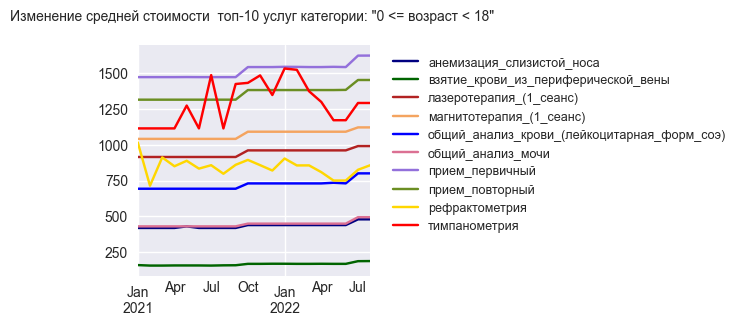

анемизация_слизистой_носа                      0.125
взятие_крови_из_периферической_вены            0.148
лазеротерапия_(1_сеанс)                        0.077
магнитотерапия_(1_сеанс)                       0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)    0.134
общий_анализ_мочи                              0.129
прием_первичный                                0.093
прием_повторный                                0.094
рефрактометрия                                -0.186
тимпанометрия                                  0.137
dtype: float64


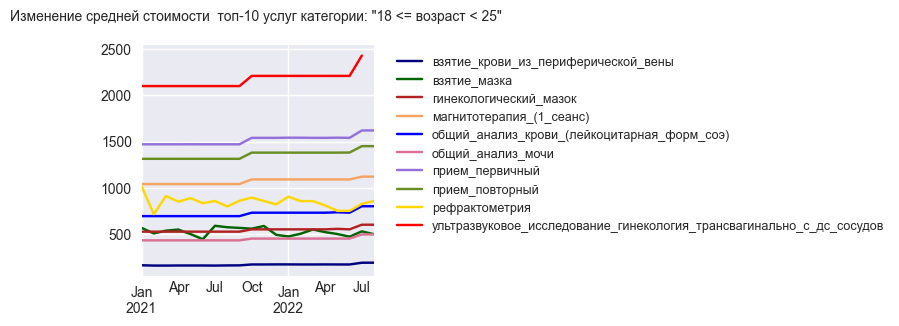

взятие_крови_из_периферической_вены                                     0.148
взятие_мазка                                                           -0.138
гинекологический_мазок                                                  0.125
магнитотерапия_(1_сеанс)                                                0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)                             0.134
общий_анализ_мочи                                                       0.129
прием_первичный                                                         0.093
прием_повторный                                                         0.094
рефрактометрия                                                         -0.186
ультразвуковое_исследование_гинекология_трансвагинально_с_дс_сосудов      NaN
dtype: float64


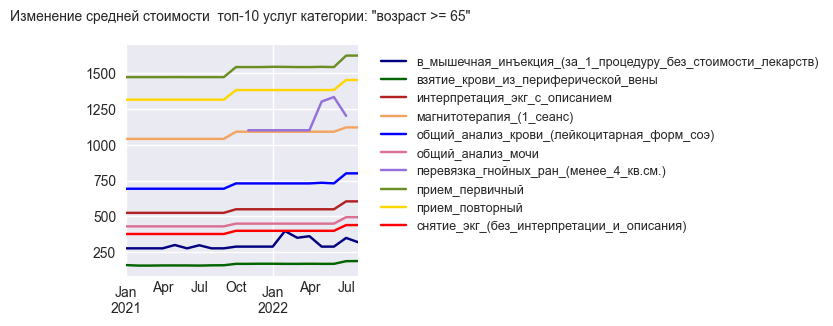

в_мышечная_инъекция_(за_1_процедуру_без_стоимости_лекарств)   0.131
взятие_крови_из_периферической_вены                           0.148
интерпретация_экг_с_описанием                                 0.132
магнитотерапия_(1_сеанс)                                      0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)                   0.134
общий_анализ_мочи                                             0.129
перевязка_гнойных_ран_(менее_4_кв.см.)                          NaN
прием_первичный                                               0.093
прием_повторный                                               0.094
снятие_экг_(без_интерпретации_и_описания)                     0.141
dtype: float64


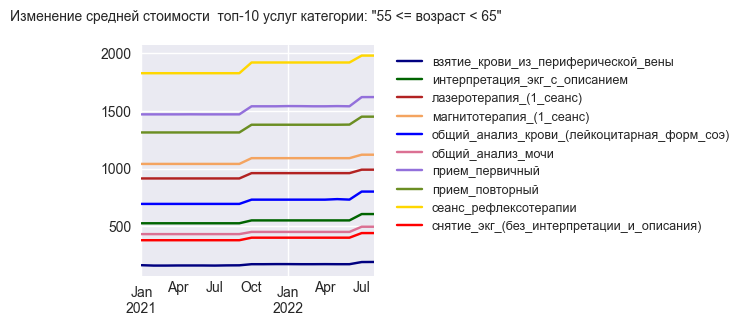

взятие_крови_из_периферической_вены           0.148
интерпретация_экг_с_описанием                 0.132
лазеротерапия_(1_сеанс)                       0.077
магнитотерапия_(1_сеанс)                      0.071
общий_анализ_крови_(лейкоцитарная_форм_соэ)   0.134
общий_анализ_мочи                             0.129
прием_первичный                               0.093
прием_повторный                               0.094
сеанс_рефлексотерапии                         0.077
снятие_экг_(без_интерпретации_и_описания)     0.141
dtype: float64


In [63]:
for dimension in data['age_category'].unique():
    rise_service = plot_top_10(data, dimension, 'age_category')
    print(rise_service)

**Промежуточный вывод по категории "age_category":**
* систематическое повышение стоимости почти всех услуг 10.2021 и 07.2022
* отличается характер изменения цен для некторых услуг из категорий: 
  * тимпанометрия имеет свой характер изменения стоимости, имеет отношение к сезону, а точнее к пикам обострений сезонной аллергии
  * рефрактометрия — скорее всего акции
  * инъекции — скорее всего связано с материалами


**Промежуточный обобщающий вывод по топ-10 услугам:**
* в целом средняя стоимость на самые популярные услуги в рассматриваемый период меняласась 2 раза: 10.2021 и 07.2022
* есть несколько сезонных изменений цен на услуги
* есть несколько акционных изменений на услуги
* возможно есть изменение стоимости услуг в категории анализов из-за изменения стоимости материалов

<a id='med_case'></a>
### 5.6. Медицинский кейс

Медицинский кейс клиники — последовательность медицинских услуг, полученных одним застрахованным с интервалом между любыми соседними по дате услугами не более 14 дней

In [64]:
# определение для каждого застрахованного: дней визитов, количества полученных услуг в каждый визит, 
# а также общая сумма, которую пациент заплатил за визит
insureds = (
    data.groupby(['insured', 'service_date'], as_index=False)
    .agg({'sex_id':'first', 'age_category':'first', 'service_amount': ['sum', 'count']})
) 
insureds.columns = ['insured', 'service_date', 'sex_id', 'age_category', 'sum_amount', 'cnt_service']
insureds.head()

,insured,service_date,sex_id,age_category,sum_amount,cnt_service
0,125073,2021-01-11,женский,возраст >= 65,2321,3
1,125073,2021-01-16,женский,возраст >= 65,1827,1
2,125073,2021-01-17,женский,возраст >= 65,3813,2
3,125073,2021-01-23,женский,возраст >= 65,1313,1
4,125073,2021-09-21,женский,возраст >= 65,2940,2


In [65]:
# считаем разницу между визитами кажого пациента
for i in range(1, insureds.shape[0]):    
    if insureds.loc[i, 'insured'] == insureds.loc[i-1, 'insured']:
        insureds.loc[i, 'time_delta'] = (
                insureds.loc[i, 'service_date'] - insureds.loc[i-1, 'service_date'])
    elif insureds.loc[i, 'insured'] != insureds.loc[i-1, 'insured']:
        continue
insureds.head()        

,insured,service_date,sex_id,age_category,sum_amount,cnt_service,time_delta
0,125073,2021-01-11,женский,возраст >= 65,2321,3,NaT
1,125073,2021-01-16,женский,возраст >= 65,1827,1,5 days
2,125073,2021-01-17,женский,возраст >= 65,3813,2,1 days
3,125073,2021-01-23,женский,возраст >= 65,1313,1,6 days
4,125073,2021-09-21,женский,возраст >= 65,2940,2,241 days


In [66]:
insureds['time_delta'] = insureds['time_delta'].dt.days
insureds.head()

,insured,service_date,sex_id,age_category,sum_amount,cnt_service,time_delta
0,125073,2021-01-11,женский,возраст >= 65,2321,3,NaN
1,125073,2021-01-16,женский,возраст >= 65,1827,1,5.000
2,125073,2021-01-17,женский,возраст >= 65,3813,2,1.000
3,125073,2021-01-23,женский,возраст >= 65,1313,1,6.000
4,125073,2021-09-21,женский,возраст >= 65,2940,2,241.000


In [67]:
# определяем медицинские кейсы по разницам между визитами 'time_delta'
j = 1
insureds.loc[0, 'med_case'] = j

for i in range(1, insureds.shape[0]):    
    if (insureds.loc[i, 'insured'] == insureds.loc[i-1, 'insured'] and
    insureds.loc[i, 'time_delta'] <= 14):
        insureds.loc[i, 'time_delta_in_case'] = insureds.loc[i, 'time_delta']
        insureds.loc[i, 'med_case'] = insureds.loc[i-1, 'med_case']
    elif (insureds.loc[i, 'insured'] == insureds.loc[i-1, 'insured'] and
    insureds.loc[i, 'time_delta'] > 14):
        insureds.loc[i, 'time_delta_in_case'] = 0
        insureds.loc[i, 'med_case'] = insureds.loc[i-1, 'med_case'] + 1        
    elif insureds.loc[i, 'insured'] != insureds.loc[i-1, 'insured']:
        insureds.loc[i, 'med_case'] = insureds.loc[i-1, 'med_case'] + 1
    else:
        continue


In [68]:
insureds.tail()

,insured,service_date,sex_id,age_category,sum_amount,cnt_service,time_delta,med_case,time_delta_in_case
30285,1306795,2022-08-18,мужской,25 <= возраст < 35,6107,7,1.000,"8,959.000",1.000
30286,1306795,2022-08-24,мужской,25 <= возраст < 35,7510,4,6.000,"8,959.000",6.000
30287,1306795,2022-08-27,мужской,25 <= возраст < 35,4000,1,3.000,"8,959.000",3.000
30288,1306795,2022-08-28,мужской,25 <= возраст < 35,1450,1,1.000,"8,959.000",1.000
30289,1306795,2022-08-31,мужской,25 <= возраст < 35,1620,1,3.000,"8,959.000",3.000


In [69]:
# расчет стоимости медицинского кейса и количества входящих в него услуг
med_case = (
    insureds.groupby(['med_case'], as_index=False)
    .agg({'service_date':['first', 'count'], 'time_delta':'sum', 'sum_amount':'sum', 
          'cnt_service':'sum', 'insured':'first', 'sex_id':'first', 'age_category': 'first'})
) 

med_case.columns = (
    ['med_case', 'dt_first', 'visits_cnt', 'total_days', 'sum_amount', 'cnt_service', 'insured', 'sex_id', 'age_category']
) 
med_case['med_case'] = med_case['med_case'].astype('int')
med_case['total_days'] = med_case['total_days'].astype('int')
med_case.head()

,med_case,dt_first,visits_cnt,total_days,sum_amount,cnt_service,insured,sex_id,age_category
0,1,2021-01-11,4,12,9274,7,125073,женский,возраст >= 65
1,2,2021-09-21,6,255,16246,13,125073,женский,возраст >= 65
2,3,2021-11-16,5,54,7560,7,125073,женский,возраст >= 65
3,4,2021-01-22,2,7,4479,4,125094,женский,35 <= возраст < 45
4,5,2021-10-06,2,255,15280,9,125094,женский,35 <= возраст < 45


In [70]:
# добавляем вспомогательные временные столбцы
med_case['month_n'] = med_case['dt_first'].dt.month
med_case['year'] = med_case['dt_first'].dt.year
med_case['month'] = med_case['dt_first'].dt.date.astype('datetime64[M]')
med_case['week'] = med_case['dt_first'].dt.date.astype('datetime64[W]')
med_case['week_n'] = med_case['dt_first'].dt.isocalendar().week
med_case['month_p'] = med_case['month'].dt.strftime('%Y-%m')

# сортировка по дате начала медицинского кейса
med_case = med_case.sort_values(by='dt_first')
med_case.head()

,med_case,dt_first,visits_cnt,total_days,sum_amount,cnt_service,insured,sex_id,age_category,month_n,year,month,week,week_n,month_p
271,272,2021-01-03,2,2,4097,5,174009,мужской,0 <= возраст < 18,1,2021,2021-01-01,2020-12-31,53,2021-01
3007,3008,2021-01-03,5,5,10722,11,530752,женский,45 <= возраст < 55,1,2021,2021-01-01,2020-12-31,53,2021-01
40,41,2021-01-03,3,3,7320,5,142562,мужской,35 <= возраст < 45,1,2021,2021-01-01,2020-12-31,53,2021-01
996,997,2021-01-03,12,29,32853,29,243321,женский,35 <= возраст < 45,1,2021,2021-01-01,2020-12-31,53,2021-01
299,300,2021-01-03,6,37,26784,20,176359,женский,35 <= возраст < 45,1,2021,2021-01-01,2020-12-31,53,2021-01


<a id='med_case_fig'></a>

In [71]:
fig = px.scatter(med_case, x="dt_first", y="visits_cnt", marginal_y="histogram", 
                 trendline='ols',trendline_color_override="black")
annotations = []
annotations.append(dict(xref='paper', yref='paper', x=0.0, y=1.05,
                              xanchor='left', yanchor='bottom',
                              text='Разброс количества визитов за кейс во времени',
                              font=dict(size=18),
                              showarrow=False))

fig.update_layout(annotations=annotations,
    xaxis={'title':'', 'showticklabels': True},
    yaxis={'title':'', 'showticklabels': True})
fig.show()

**Промежуточный вывод:**
* характер распределения медицинских кейсов по количеству визитов — обратно пропорционален количеству визитов за кейс: больше всего кейсов с одним визитом (практически 50%) и наоборот — меньшего всего кейсов в с большим количеством визитов
* в рассматриваемый период не наблюдается тендеции увеличения числа визитов за кейс, просто увеличивается число кейсов и с одним визитом, и с большим количеством визитов
* рассматривать выручку по кейсу нецелесообразно, так как она приходит в клинику в течении всего кейса за каждый визит отдельно
* также часть медицинских кейсов, стартовавших или имевших очередной визит во второй половине августа еще не окончена, так как мы не знаем, будет ли следующий визит в сентябре или нет

<a id='total_amount_category'></a>
### 5.7. Оценка зависимости выручки от различных категорий

Проверям, зависит ли выручка от таких категорий как: 
* пол пациента: 'sex_id'
* возраст пациента: 'age_category'
* количества услуг по типу: 'service_category'
* количества услуг по ценовой категории: 'amount_category'

**Пол пациента: 'sex_id'**

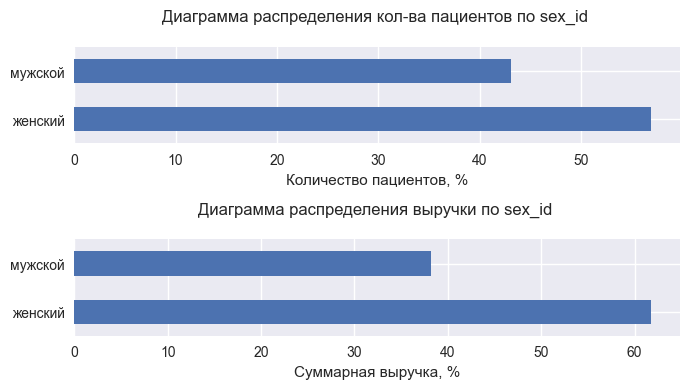

,insured,service_amount,"insured/ total, %","service_amount/ total, %"
sex_id,,,,
женский,2555,61495444,56.942,61.778
мужской,1932,38047323,43.058,38.222


In [72]:
plot_group(data, 'sex_id')

<a id='amount_sex_id'><a/>

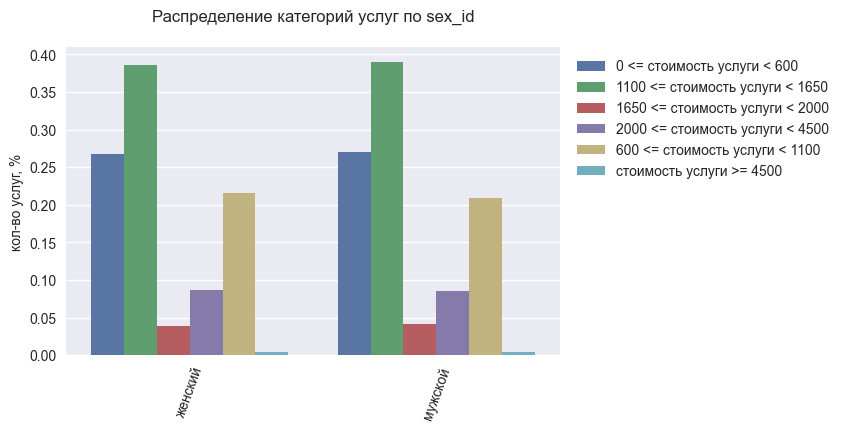

In [73]:
amount_dif_cat(data, 'sex_id')

**Промежуточный вывод: за весь рассматриваемый период**
* пациенты женского пола принесли выручки больше пациентов мужского пола в ~1,5 раза. Это связано с тем, что пациентов женского пола больше пациентов мужского пола

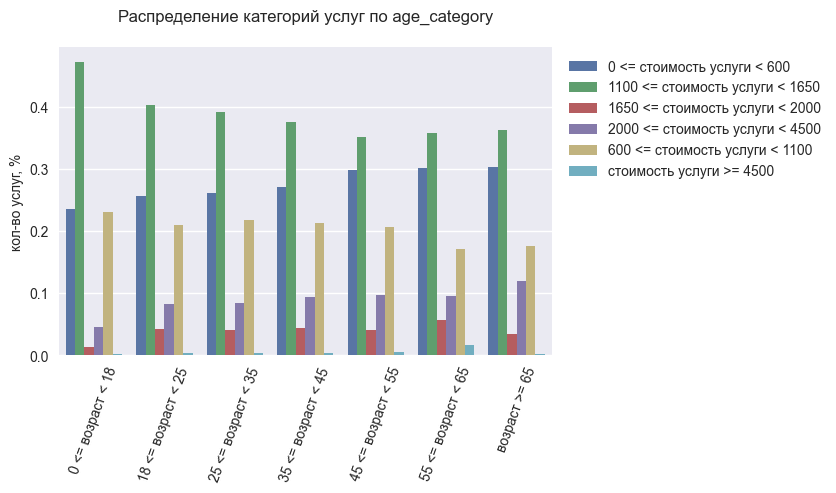

In [74]:
amount_dif_cat(data, 'age_category')

<a id='amount_age'><a/>

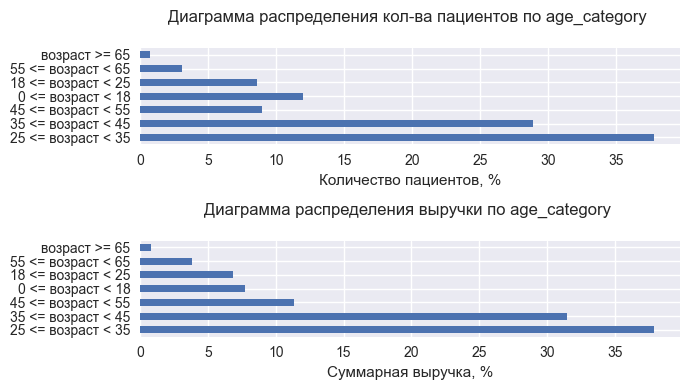

,insured,service_amount,"insured/ total, %","service_amount/ total, %"
age_category,,,,
25 <= возраст < 35,1726,37732988,37.801,37.906
35 <= возраст < 45,1319,31296855,28.887,31.441
45 <= возраст < 55,410,11321083,8.979,11.373
0 <= возраст < 18,548,7714961,12.002,7.750
18 <= возраст < 25,391,6824090,8.563,6.855
55 <= возраст < 65,140,3816583,3.066,3.834
возраст >= 65,32,836207,0.701,0.840


In [75]:
plot_group(data, 'age_category')

**Промежуточный вывод: за весь рассматриваемый период**
* самый больной возраст — от 25 до 35 лет, так как они принесли ~38% общей выручки, далее 35-45: ~31,5%, на третьем месте  45-55: ~11,4%, пациенты остальных возрастов принесли меньше 10% по каждой категории. 


1. По большей части объем выручки связан с количеством пациентов по категориям, но зависимость не совсем прямая. 
   * Например, детей до 18 лет больше, чем пациентов 45-55 лет, а выручки они принесли меньше, или почти одинаковая выручка для категори 0-18 и 18-25 при большей разнице в количестве пациентов
2. Это связано с тем, что у пациентов 45-55 лет больше услуг категорий "средняя+", "высокая" и "высокая+", чем у категории 0-18. У пациентов 18-25 лет также больше услуг категорий "средняя+", "высокая" и "высокая+", чем у категории 0-18

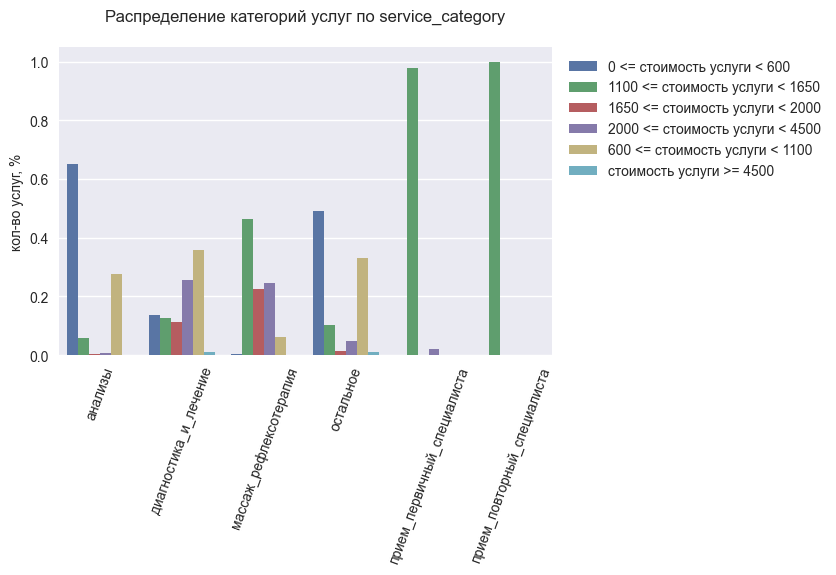

In [76]:
amount_dif_cat(data, 'service_category')

<a id='amount_ser'><a/>

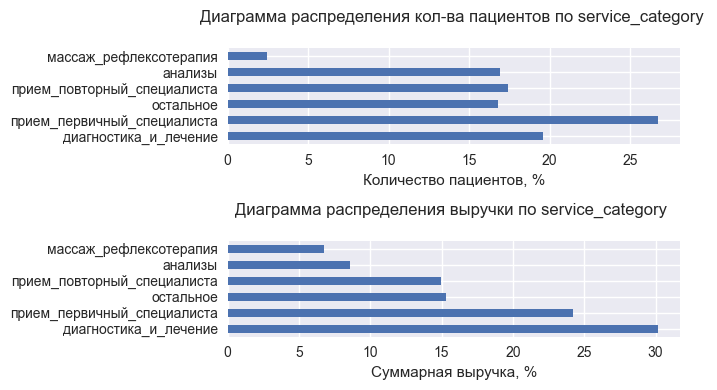

,insured,service_amount,"insured/ total, %","service_amount/ total, %"
service_category,,,,
диагностика_и_лечение,3147,30067103,19.600,30.205
прием_первичный_специалиста,4297,24086862,26.763,24.198
остальное,2701,15250169,16.822,15.320
прием_повторный_специалиста,2800,14909509,17.439,14.978
анализы,2714,8528113,16.903,8.567
массаж_рефлексотерапия,397,6701011,2.473,6.732


In [77]:
plot_group(data, 'service_category')

**Промежуточный вывод: за весь рассматриваемый период**
* больше всего выручки пресли категории диагностика_и_лечение: ~30,2%, прием_первичный: ~24,2% и почти одинаковые значения у категорий прием_повторный и остальное: ~15%

    1. основной ценовой диапазон первичного_приема и повторного_приема — средний 
    2. категория диагностика_и_лечение примерно на 50% состоит из ценовых диапазонов средний, средний+, высокий, высоки+. Большая часть дорогих услуг именно в категории диагностика_и_лечение
    3. категории анализы и остальное состоят преимущественно из услуг ценовой категории низкая и низкая+
    4. категория массаж_рефлексотерапия при малом количестве сравнима по выручке с категорией анализы (которых в ~7 раз больше ) из-за ценовых категорий услуг(средняя и средняя+)

* выручка зависит не только от количества услуг, но и от категории ценового диапазона

<a id='amount'><a/>

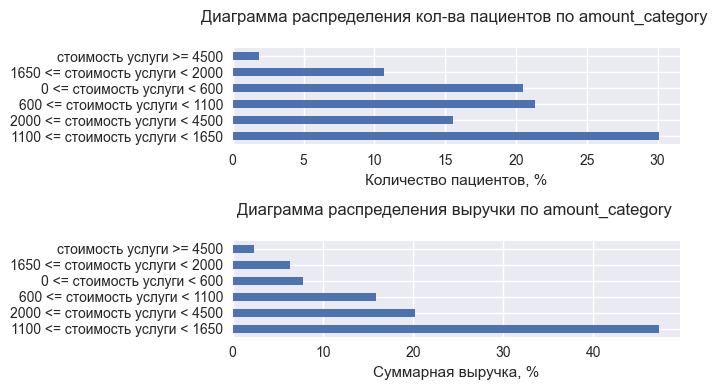

,insured,service_amount,"insured/ total, %","service_amount/ total, %"
amount_category,,,,
1100 <= стоимость услуги < 1650,4393,47054070,30.077,47.270
2000 <= стоимость услуги < 4500,2273,20110103,15.562,20.202
600 <= стоимость услуги < 1100,3114,15859642,21.320,15.932
0 <= стоимость услуги < 600,2994,7784025,20.498,7.820
1650 <= стоимость услуги < 2000,1556,6355007,10.653,6.384
стоимость услуги >= 4500,276,2379920,1.890,2.391


In [78]:
plot_group(data, 'amount_category')

**Промежуточный вывод: за весь рассматриваемый период**
* больше всего выручки от следующих ценовых категорий: 
  * средняя — ~47,3%, при этом количество — ~30,1%
  * высокая — ~20,2%, при этом количество — ~15,6%
  * низкая+ — ~15,9%, при этом количество — ~21,3%



<a id='summary'></a>
## 6. Общий вывод

**Цель проекта:**

Оценить вклад различных факторов в изменение средней стоимости лечения в медицинской клинике в разные годы.
Проанализировать изменение выручки медицинского центра в 2022 году относительно 2021 и выявить ключевые факторы, повлиявшие на это изменение.

**Общие данные:**
* Рассматриваемый период: 01.2021- 08.2022
* Общая выручка за весь период: 99 542 767,00 р.
  - Общая выручка за 2021 год (01-12 месяцы): 50 556 105,00 р.
  - Общая выручка за 2022 год (01-08 месяцы): 48 986 662,00 р.
* Общее число уникальных пациентов: 4487 человек
  - количество визитов в 2021 году (01-12 месяцы): 15 856
  - количество визитов в 2022 году (01-08 месяцы): 14 434

**Динамика выручки:**
* 2022 год показывает более динамичное изменение объема выручки и количества оказанных услуг
* каждый месяц 2022 года до 06 месяца включительно показывает рост и по количеству визитов, и по выручке относительно тех же месяцев в 2021 году [график динамики общей выручки](#total_amount)
* при сравнении одних и тех же месяцев 2021 и 2022 года, прирост выручки выше, чем прирост количества услуг на 7-12%. В июле же 2022 года выручка больше выручки 07.2021 на 60%, а количество услуг на 36,6%. Это говорит о том, что услуги в 2022 году дороже, чем те же услуги в 2021 году.
* 08.2022 наблюдается падение и количества визитов, и количества услуг и соответственно выручки до значений марта 2021 года


**Причины падения выручки**
* стоимость визита выросла из-за повышения стоимости услуг 10.2021 и 07.2022. Для оценки критичности падения выручки 08.2022 не хватает данных хотя бы за 09.2022, так как 11.20221 году также наблюдается падение выручки после повышения стоимости услуг 10.2021, но в декабре выручка начала подниматься
* 08.2022 исчезли некоторые популярные услуги для пациентов женского пола, возможно вместе с ними ушло часть пациентов в другие клиники
* возможно после второго повышения стоимости на почти все услуги — часть пациентов ушла к конкурентам
* слишком резкий скачок 04.2021, скорее всего связан с сезонными акциями, поэтому дальнейшее снижение — это возможное возвращение к исходному плану продаж


**Исследование "визита". На выручку влияют изменения количества визитов за день, количества услуг за визит и стоимости визита**
* в рассматриваемый период среднее число визитов в день росло, за исключением государственных праздников и выходных, в которые наблюдаются падения среднего количества визитов и периода 12.21-01.22, в который наблюдается снижение скорее всего из-за зимних отпусков [см.график](#visits_count_day)
* с увеличением числа визитов можно отметить одновременно увеличение разброса и стоимостей визитов, и количества услуг за визит с течением времени
* при этом наблюдается увеличение средней стоимости визита [см.график](#mean_cost_visit) при уменьшении среднего количества услуг за визит [см.график](#mean_count_service)

**Исследование "стоимости услуг". На выручку влияют стоимости услуг**
* практически для всех услуг дважды наблюдается систематическое повышение стоимости: 10.2021 и 07.2022. В целом цены на популярные услуги из категории анализов повысились до 15%, на приемы врачей - на 9-10%, и на различные исследования - на 7-8%
* стоит отметить, что в августе **исчезли некоторые популярные услуги, которые стабильно оказывались в течение всего рассматриваемого периода**: 
  * ультразвуковое_исследование_гинекология_трансвагинально_с_дс_сосудов,
  * классический_лечебный_массаж_шейно-грудного_отдела,
  * массаж_пояснично-крестцового_отдела, 
  * ультразвуковое_исследование_щитовидной_железы_с_дс_сосудов,  
* распределение услуг по категориям за каждый месяц с течением времени практически не меняется [см.график](#rate_service_cat)
* в зависимости от пола и возраста набор популярных услуг разный [см.графики по полу](#sex_id_service) и [см.графики по возрасту](#age_cat_service), а также в зависимости от категории услуг и ценового диапазона, наблюдаюся акционные изменения стоимости [см.график](#service_cat_service) и [см.график](#amount_cat_service)
* отличается характер изменения цен для некторых топ-10 услуг из категорий: 
  * "средняя" ценовая категория: услуга тимпанометрия — свой характер изменения стоимости, имеет отношение к сезону, а точнее к пикам обострений сезонной аллергии или к вирусным пикам
  * "низкая+" ценовая категория: 
    * фонофорез (один выбивающийся пик из общией картины), 
    * внутримышечные инъекции и взятие мазка: возможная причина хаотичного изменения стоимости — изменение стоимости расходных материалов, 
    * рефрактометрия и измерение_внутрилазного_давления: кривые повторяют друг друга — скорее всего изменение цены связано с акциями на исследование зрения
  * "средняя+" ценовая категория: ультразвуковое_исследование_сустава и рентгенография_крупного_сустава — появление пиков происходит практически в одно время, возможно связано с акциями на диагностику суставов
  * "высокая" ценовая категория: ударно-волновая_терапия — свой характер кривой
  * "высокая+" ценовая категория: видно, что с 10.2021 многие услуги пропали вообще, или предоставлялись лишь изредка, либо стоимость резко росла или падала, например, ударно-волновая_терапия одним пиком залезла в категорию дорогих услуг
  * прием_первичный_специалиста: до 10.2021 года были такие услуги как консультация врача перед вакцинацией, а также выезд врача на дом, после 10.2021 года этих услуг уже нет. Я думаю, что они связаны с ковидными мерами
  * массаж_рефлексотерапия: мануальная_терапия_(1_отдел) имеет 2 пика в мае и декабре 2021 года, возможно акция

**Исследование "постоянных" и "разовых" пациентов. На выручку влияет количество постоянных клиентов, либо количество "разовых" клиентов**
* всего клинику посетило 4487 уникальных пациента
* 25% застрахованных посетило клиниику только один раз. По медианному значению можно предположить, что "разовый" визит — это прием врача и какие-то анализы. Есть небольшое кол-во выбросов, которые показывают стоимость визитов, в которых комплекс услуг. "Разовые" пациенты принесли всего 3,5% от всей выручки: для 25% от всех уникальных пациентов - это незначительно, поэтому можно сделать вывод, что "разовые" пациенты не влияют на рост и падение выручки в течение рассматриваемого периода [см.график](#one_time_insured)
* 25% застрахованных посетило клиниику 2-3 раза. Оставшиеся 50% пациентов посетило клинику от 4 до 94 раз
* основную выручку принесли пациенты, которые приходили более 1 раза

**Исследование "медицинский кейс". На выручку влияет изменение количества медицинских кейсов, их стоимости и длительности**
* характер распределения медицинских кейсов по количеству визитов — обратно пропорционален количеству визитов за кейс: больше всего кейсов с одним визитом (практически 50%) и наоборот — меньшего всего кейсов в с большим количеством визитов [см.график](#med_case_fig)
* в рассматриваемый период не наблюдается тендеции в увеличении количества визитов за кейс
* рассматривать выручку по кейсу нецелесообразно, так как она приходит в клинику в течении всего кейса за каждый визит отдельно
* также часть медицинских кейсов, стартовавших или имевших очередной визит во второй половине августа еще не окончена, так как мы не знаем, будет ли следующий визит в сентябре или нет

**Исследование "влияние пола, возраста, категории услуг на общую выручку". На выручку влияют пол и возраст пациента, категория услуг**
* пациенты женского пола принесли выручки больше пациентов мужского пола в ~1,5 раза. Это связано с тем, что пациентов женского пола больше пациентов мужского пола [см.график](#amount_sex_id)
* самый больной возраст — от 25 до 35 лет, так как они принесли ~38% общей выручки, далее 35-45: ~31,5%, на третьем месте  45-55: ~11,4%, пациенты остальных возрастов принесли меньше 10% по каждой категории. По большей части объем выручки связан с количеством пациентов по категориям, но зависимость не совсем прямая [см.график](#amount_age)
  * ценовая категория услуг зависит от возраста: например, у пациентов 45-55 лет больше услуг категорий "средняя+", "высокая" и "высокая+", чем у категории 0-18. У пациентов 18-25 лет также больше услуг категорий "средняя+", "высокая" и "высокая+", чем у категории 0-18
* больше всего выручки пресли категории диагностика_и_лечение: ~30,2%, прием_первичный: ~24,2% и почти одинаковые значения у категорий прием_повторный и остальное: ~15% [см.график](#amount_ser)
* больше всего выручки от следующих ценовых категорий [см.график](#amount): 
  * средняя — ~47,3%, при этом количество — ~30,1%
  * высокая — ~20,2%, при этом количество — ~15,6%
  * низкая+ — ~15,9%, при этом количество — ~21,3%

**итого:** общая выручка зависит не только от количества пациентов, но и от возраста пациента, так как разные возрасты  берут услуги из разных ценовых категорий услуг, категории выбираемых услуг также влияют на общую выручку
